# load packages

In [1]:
# scanpy packages 
import scanpy as sc
import scanpy.external as sce
import anndata as anndata
#import diffxpy.api as de
from anndata import AnnData

# other packages
import time
import os
import numpy as np
import seaborn as sns
import pandas as pd
import re
import h5py
import scipy

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.patches as patches
import matplotlib.colors as colors
import matplotlib.font_manager
%matplotlib inline


# other packages
import glob
from collections import OrderedDict
from scipy.sparse import csr_matrix
#import diffxpy.api as de
from scanpy.external.pp import magic
from scipy.stats import zscore
import scipy.cluster.hierarchy as hc
from statistics import median
import math
from typing import Union
import phenograph
from sklearn.metrics import adjusted_rand_score

import numpy.matlib

from kneed import KneeLocator

from scrnaseq_preprocessing_utils import *
from hierarchy import *

In [2]:
#set style
sns.set_style('white')
# define colors
color_map_clusters = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059",
"#FFDBE5", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

color_map_clusters_nogrey = ["#FFFF00", "#1CE6FF", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF", "#997D87",
"#5A0007", "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]

perturbation_map = ['#EFD060','#0289DE','#0289DE','#DCA6C4']
stage_map = ['#EFD060','#0289DE','#67C6F8','#DCA6C4']
stage_map_2 = ['#EFD060','#0289DE','#DCA6C4']
blue_red = ['#0E518F','#DF480F']
perturbation_stage_map_2 = ['#F95957', '#FF0300','#EFD060','#0289DE','#0289DE','#DCA6C4','#EFD060','#0289DE','#DCA6C4']
perturbation_stage_map = ['#F95957', '#FF0300','#e1e1e1','#e1e1e1','#e1e1e1','#e1e1e1', '#EFD060','#0289DE','#DCA6C4']
color_map_clusters_plt = cm = LinearSegmentedColormap.from_list(
        'color_map_clusters', color_map_clusters)

#scanpy layout
sc.set_figure_params(scanpy=True, dpi=80, dpi_save=80, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')

# attach obs and .raw element to scran normalized subset data

## load data

In [3]:
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran.h5ad'
adata_raw_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_leukocytes_scran_clustered_annotated_imputed_hvg10000_and_marker_genes_imputed_myeloid.h5ad' # adata of all TIL containing raw counts 
save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts.h5ad'

#parameters
save_adata =True

In [102]:
#load subset files
adata = sc.read(adata_path)
adata_raw = sc.read(adata_raw_path)

In [103]:
print(adata_raw.X)

[[0.57591295 0.         0.98640424 ... 0.         0.         0.        ]
 [0.         0.         0.8525622  ... 0.         0.         0.        ]
 [0.         0.         1.3021511  ... 0.         0.         0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.78433627 0.         0.78433627]
 [0.         0.         0.6504877  ... 0.         0.         0.        ]]


In [104]:
adata_raw.X = adata_raw.raw[adata_raw.obs_names, adata_raw.var_names].X

In [105]:
print(adata_raw.X)

  (0, 482)	2.0
  (0, 13211)	1.0
  (0, 6956)	1.0
  (0, 217)	1.0
  (0, 12560)	1.0
  (0, 15901)	1.0
  (0, 5864)	1.0
  (0, 11564)	1.0
  (0, 8694)	4.0
  (0, 10548)	1.0
  (0, 4972)	1.0
  (0, 11842)	1.0
  (0, 2461)	1.0
  (0, 2447)	1.0
  (0, 10142)	1.0
  (0, 15368)	1.0
  (0, 3852)	1.0
  (0, 18064)	1.0
  (0, 6280)	1.0
  (0, 8275)	1.0
  (0, 12711)	1.0
  (0, 9627)	1.0
  (0, 8230)	1.0
  (0, 9648)	2.0
  (0, 16673)	4.0
  :	:
  (17022, 3110)	1.0
  (17022, 13947)	1.0
  (17022, 16684)	27.0
  (17022, 16959)	1.0
  (17022, 15078)	1.0
  (17022, 9854)	1.0
  (17022, 16878)	2.0
  (17022, 17618)	1.0
  (17022, 3487)	1.0
  (17022, 13572)	7.0
  (17022, 13928)	5.0
  (17022, 11561)	4.0
  (17022, 16284)	1.0
  (17022, 3337)	1.0
  (17022, 5860)	2.0
  (17022, 1875)	1.0
  (17022, 6840)	1.0
  (17022, 9690)	1.0
  (17022, 14541)	1.0
  (17022, 7871)	1.0
  (17022, 6743)	1.0
  (17022, 2608)	1.0
  (17022, 7856)	1.0
  (17022, 5451)	1.0
  (17022, 4350)	2.0


### subset raw_adata and store in X element of immune subset data

In [106]:
adata_raw.obs_names

Index(['235129942239980-T19', '231891434630052-T19', '157690371652972-T09',
       '240482277354740-T17', '201670683215723-T17', '227516844238574-T17',
       '226970309933878-T12', '195958618635550-T17', '155911431080677-T19',
       '162090668677365-T04',
       ...
       '130754452774107-N08', '166416893524701-T19', '235007414561062-T22',
       '169174277672366-T19', '235199333293413-T17', '228042050850206-T23',
       '230611637188966-T12', '155972653468459-T19', '165851837155571-T17',
       '191691434440987-T17'],
      dtype='object', length=17023)

In [107]:
adata.obs_names

Index(['235129942239980-T19', '231891434630052-T19', '157690371652972-T09',
       '240482277354740-T17', '201670683215723-T17', '227516844238574-T17',
       '226970309933878-T12', '195958618635550-T17', '155911431080677-T19',
       '162090668677365-T04',
       ...
       '130754452774107-N08', '166416893524701-T19', '235007414561062-T22',
       '169174277672366-T19', '235199333293413-T17', '228042050850206-T23',
       '230611637188966-T12', '155972653468459-T19', '165851837155571-T17',
       '191691434440987-T17'],
      dtype='object', length=17023)

In [108]:
adata.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes
235129942239980-T19,1790,7.490529,2084.532715,7.642780,11.108857,19.111213,30.959363,52.727554
231891434630052-T19,1947,7.574558,2002.307495,7.602555,12.348598,21.384177,33.027131,52.702435
157690371652972-T09,858,6.755769,1641.908569,7.404223,13.127729,22.636256,37.204040,66.865380
240482277354740-T17,638,6.459904,1320.262329,7.186343,15.532698,25.806221,42.613068,81.919184
201670683215723-T17,1126,7.027315,1729.866943,7.456378,12.005732,20.699877,34.092870,60.866501
...,...,...,...,...,...,...,...,...
228042050850206-T23,1022,6.930495,1747.993652,7.466796,13.371677,22.822699,36.086602,61.905778
230611637188966-T12,1496,7.311218,2108.429688,7.654173,11.752248,20.663195,33.363860,56.671692
155972653468459-T19,833,6.726233,1584.097778,7.368402,14.379403,24.370368,39.784002,70.049206
165851837155571-T17,1339,7.200425,1905.768188,7.553165,12.396582,21.030931,33.836713,58.314349


In [109]:
#add raw counts
adata_raw_subset = adata_raw[adata.obs_names, adata.var_names]
adata_raw_subset

View of AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'empty_droplet_sig', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'major_subsets_colors', 'neighbors

In [110]:
print(adata_raw_subset.X)

  (0, 417)	2.0
  (0, 12156)	1.0
  (0, 6482)	1.0
  (0, 174)	1.0
  (0, 11697)	1.0
  (0, 14656)	1.0
  (0, 5460)	1.0
  (0, 10794)	1.0
  (0, 8046)	4.0
  (0, 9810)	1.0
  (0, 4619)	1.0
  (0, 11060)	1.0
  (0, 2266)	1.0
  (0, 2253)	1.0
  (0, 9435)	1.0
  (0, 14147)	1.0
  (0, 3546)	1.0
  (0, 16636)	1.0
  (0, 5847)	1.0
  (0, 7649)	1.0
  (0, 11805)	1.0
  (0, 8947)	1.0
  (0, 7609)	1.0
  (0, 8968)	2.0
  (0, 15305)	4.0
  :	:
  (17022, 2886)	1.0
  (17022, 12799)	1.0
  (17022, 15316)	27.0
  (17022, 15579)	1.0
  (17022, 13868)	1.0
  (17022, 9166)	1.0
  (17022, 15499)	2.0
  (17022, 16200)	1.0
  (17022, 3251)	1.0
  (17022, 12437)	7.0
  (17022, 12780)	5.0
  (17022, 10791)	4.0
  (17022, 15001)	1.0
  (17022, 3109)	1.0
  (17022, 5456)	2.0
  (17022, 1734)	1.0
  (17022, 6372)	1.0
  (17022, 9008)	1.0
  (17022, 13360)	1.0
  (17022, 7310)	1.0
  (17022, 6281)	1.0
  (17022, 2409)	1.0
  (17022, 7295)	1.0
  (17022, 5067)	1.0
  (17022, 4017)	2.0


In [111]:
adata_raw_subset

View of AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'empty_droplet_sig', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'major_subsets_colors', 'neighbors

In [112]:
adata_raw_subset.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,batch,primary_tumor,...,pheno_var_k10,pheno_var_k20,pheno_var_k30,pheno_var_k40,pheno_var_k50,pheno_var_k60,pheno_var_k70,pheno_var_k80,pheno_var_k90,pheno_var_k100
235129942239980-T19,1790,7.490529,1810.625732,7.501980,11.946858,20.366672,32.582846,54.343515,T19,True,...,16,17,15,7,7,10,5,12,9,7
231891434630052-T19,1948,7.575072,1709.629150,7.444616,13.461477,23.100860,35.124033,54.653606,T19,True,...,23,14,1,2,5,2,3,3,4,4
157690371652972-T09,858,6.755769,1437.595215,7.271422,13.857599,23.660459,38.386131,67.572925,T09,True,...,23,9,6,2,2,2,5,3,4,5
240482277354740-T17,638,6.459904,1175.073486,7.069937,16.209561,26.635173,43.476976,82.191378,T17,True,...,11,7,6,2,2,2,2,3,7,5
201670683215723-T17,1126,7.027315,1596.651489,7.376290,12.433153,21.318684,34.861217,61.536936,T17,True,...,14,9,12,11,7,2,5,10,9,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
228042050850206-T23,1022,6.930495,1534.075684,7.336335,14.207715,24.019338,37.455373,62.899205,T23,True,...,13,12,10,0,3,3,7,4,8,3
230611637188966-T12,1496,7.311218,1744.430542,7.464756,12.948318,22.519114,35.725853,58.870386,T12,True,...,23,17,12,11,7,10,5,12,9,7
155972653468459-T19,833,6.726233,1304.357544,7.174232,15.631131,26.073739,41.741119,71.217438,T19,True,...,19,17,15,11,7,10,5,12,9,7
165851837155571-T17,1339,7.200425,1639.968384,7.403042,13.360780,22.421123,35.559636,59.873729,T17,True,...,14,9,1,4,4,5,3,5,4,4


In [113]:
adata

AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [114]:
adata.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes
235129942239980-T19,1790,7.490529,2084.532715,7.642780,11.108857,19.111213,30.959363,52.727554
231891434630052-T19,1947,7.574558,2002.307495,7.602555,12.348598,21.384177,33.027131,52.702435
157690371652972-T09,858,6.755769,1641.908569,7.404223,13.127729,22.636256,37.204040,66.865380
240482277354740-T17,638,6.459904,1320.262329,7.186343,15.532698,25.806221,42.613068,81.919184
201670683215723-T17,1126,7.027315,1729.866943,7.456378,12.005732,20.699877,34.092870,60.866501
...,...,...,...,...,...,...,...,...
228042050850206-T23,1022,6.930495,1747.993652,7.466796,13.371677,22.822699,36.086602,61.905778
230611637188966-T12,1496,7.311218,2108.429688,7.654173,11.752248,20.663195,33.363860,56.671692
155972653468459-T19,833,6.726233,1584.097778,7.368402,14.379403,24.370368,39.784002,70.049206
165851837155571-T17,1339,7.200425,1905.768188,7.553165,12.396582,21.030931,33.836713,58.314349


In [115]:
#check if indices are the same

print('indices are the same:', list(adata.obs_names)==list(adata_raw_subset.obs_names))

indices are the same: True


In [116]:
adata_raw_subset.layers['raw'] = adata_raw_subset.raw[adata_raw_subset.obs_names, adata_raw_subset.var_names].X

In [117]:
adata.layers['raw'] = adata_raw_subset.layers['raw']

Median total count of UMI is: 2452.0


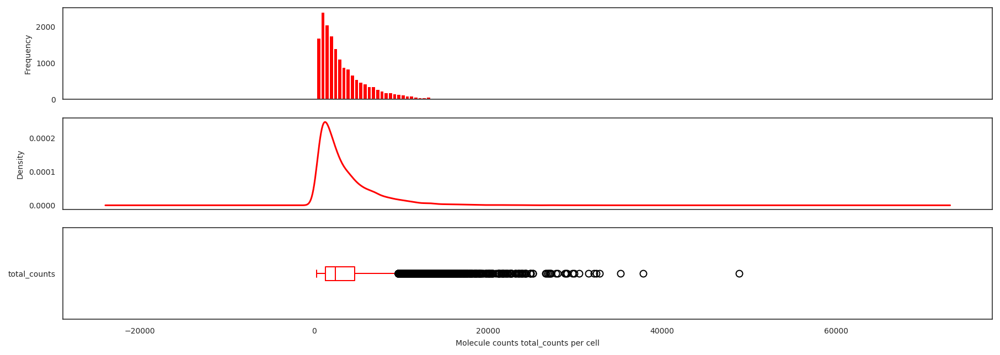

In [118]:
a = adata.copy()
a.obs['total_counts'] =  np.sum(a.layers['raw'], axis=1)
total_molecules_per_cell(a, 'total_counts')

In [119]:
if save_adata ==True:
    adata.write(save_path)
    print(save_path)

/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts.h5ad


## attach .obs and cluster

In [4]:
#data paths
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts.h5ad'
adata_obs_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_leukocytes_scran_clustered_annotated_imputed_hvg10000_and_marker_genes_imputed_myeloid.h5ad'
#adata with important obs elements
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered_v2_230125.h5ad'


#obs elements to attach from all TIL data
obs_list = [ 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 
            'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 
            'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 
            'pheno_var_k90', 'pheno_var_k100', 'major_subsets']

#clustering parameters 
pheno_names = ['pheno_M_k10', 'pheno_M_k20', 'pheno_M_k30', 'pheno_M_k40', 'pheno_M_k50', 'pheno_M_k60',
              'pheno_M_k70','pheno_M_k80','pheno_M_k90','pheno_M_k100']
pheno_k = [10,20,30,40,50,60,70,80,90,100]


In [5]:
adata = sc.read(adata_path)
adata_obs = sc.read(adata_obs_path)

In [6]:
adata

AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    layers: 'raw'

In [7]:
adata_obs

AnnData object with n_obs × n_vars = 17023 × 18116
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'empty_droplet_sig', 'doublets', 'major_subsets', 'pheno_k10', 'pheno_k20', 'pheno_k30', 'pheno_k40', 'pheno_k50', 'pheno_k60', 'pheno_k70', 'pheno_k80', 'pheno_k90', 'pheno_k100', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'major_subsets_colors', 'neighbors', 'pca'

In [8]:
#attach important .obs elements from adata_obs to adata

adatas = [adata]
print('attaching obs elements:')

for i in obs_list:
    adata.obs[i] = adata_obs.obs[i].copy()
    print('attached:', i)
    
adatas

attaching obs elements:
attached: batch
attached: primary_tumor
attached: Limited
attached: PValue_emptydrops
attached: FDR_emptydrops
attached: total_molecules
attached: percent_mito
attached: pheno_var_k10
attached: pheno_var_k20
attached: pheno_var_k30
attached: pheno_var_k40
attached: pheno_var_k50
attached: pheno_var_k60
attached: pheno_var_k70
attached: pheno_var_k80
attached: pheno_var_k90
attached: pheno_var_k100
attached: major_subsets


[AnnData object with n_obs × n_vars = 17023 × 16682
     obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
     var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
     layers: 'raw']

## cluster

## PCA neighbors clustering imputation

In [9]:
adata.X

array([[0.69035184, 0.        , 1.1553309 , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.0223384 , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.5196656 , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.9468794 , 0.        ,
        0.9468794 ],
       [0.        , 0.        , 0.7664873 , ..., 0.        , 0.        ,
        0.        ]], dtype=float32)

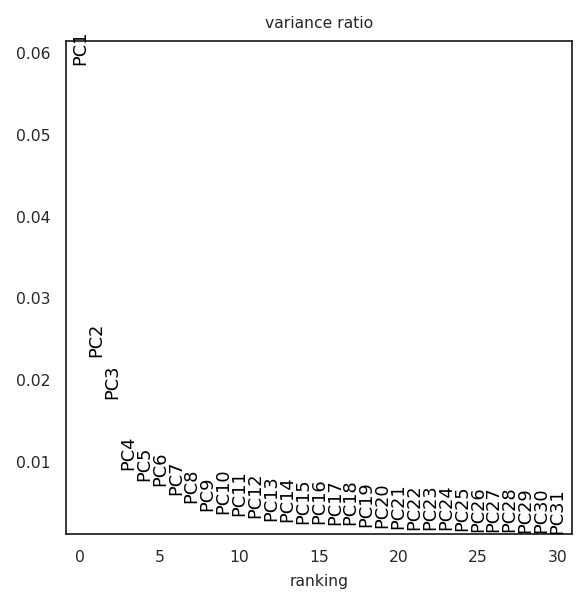

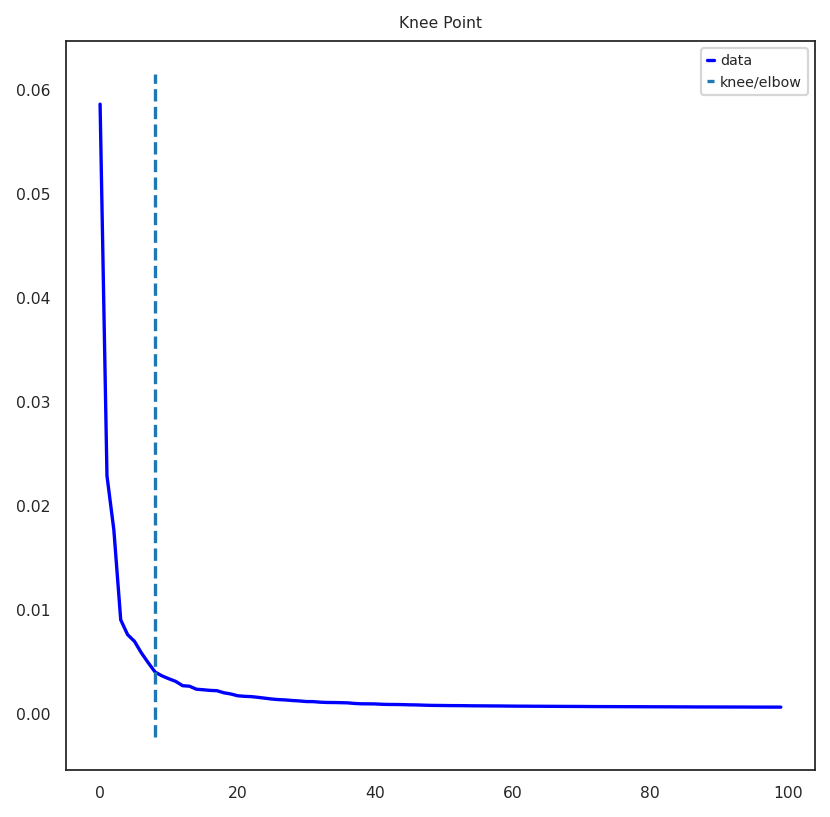

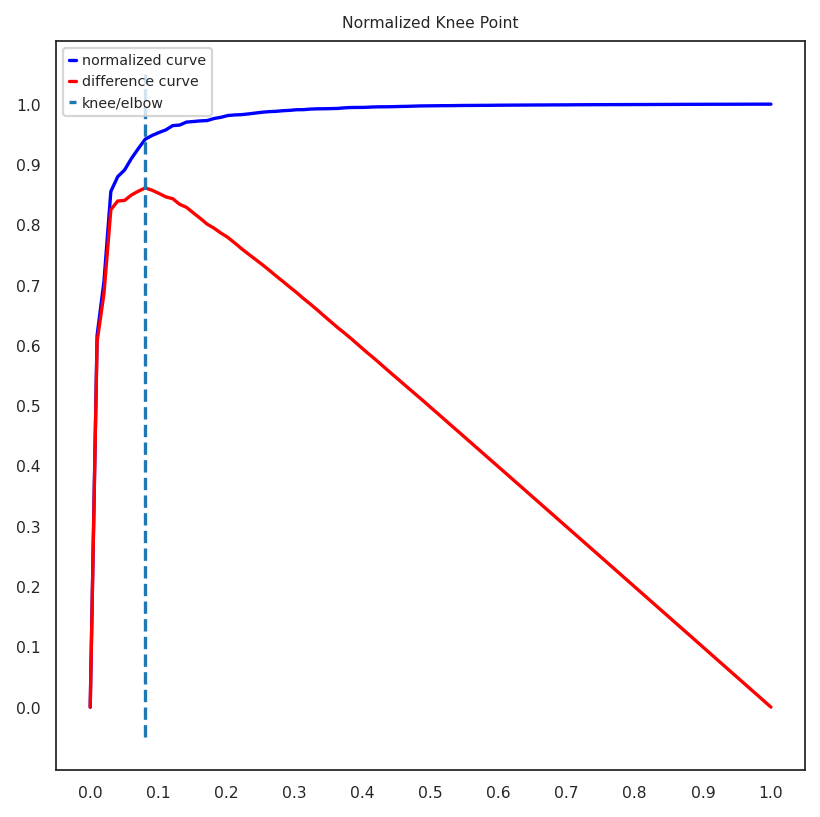

Kneepoint happens at PC: 8
8 PC explain 13.332794606685638 % of variance
2 PC explain 8.139987848699093 % of variance
3 PC explain 9.905331581830978 % of variance
4 PC explain 10.806159302592278 % of variance
5 PC explain 11.565227247774601 % of variance
6 PC explain 12.259822990745306 % of variance
7 PC explain 12.843671813607216 % of variance
8 PC explain 13.332794606685638 % of variance
9 PC explain 13.732191501185298 % of variance
10 PC explain 14.095131633803248 % of variance
11 PC explain 14.430157886818051 % of variance
12 PC explain 14.739816845394671 % of variance
13 PC explain 15.008361567743123 % of variance
14 PC explain 15.271922782994807 % of variance
15 PC explain 15.506665245629847 % of variance
16 PC explain 15.736033557914197 % of variance
17 PC explain 15.95942152198404 % of variance
18 PC explain 16.179605573415756 % of variance
19 PC explain 16.380007192492485 % of variance
20 PC explain 16.56894339248538 % of variance
21 PC explain 16.7407572735101 % of variance
2

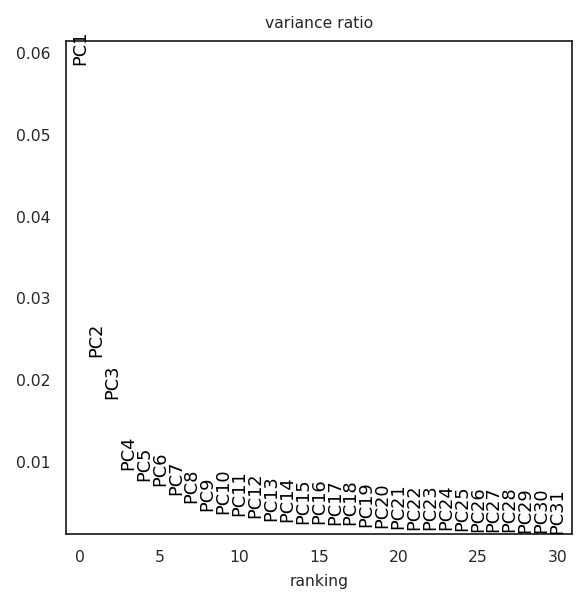

In [10]:
#select optimal number of PCs and recalculate PCs
number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=None)

In [11]:
sc.pp.neighbors(adata, n_neighbors=10, method= 'umap', n_pcs=number_of_PC_used,random_state=0)
sc.tl.umap(adata,random_state=0)

In [12]:
sc.tl.tsne(adata, random_state = 7,n_pcs=number_of_PC_used)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


In [13]:
adata

AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'pca', 'neighbors', 'umap', 'tsne'
    obsm: 'X_pca', 'X_umap', 'X_tsne'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'distances', 'connectivities'

### save data

In [14]:
#indicate save path
adata_save_path

'/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered_v2_230125.h5ad'

In [15]:
#save data
adata.write(adata_save_path)
print('adata written to', adata_save_path)

adata written to /data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered_v2_230125.h5ad


# highly variable genes

In [38]:
#data paths
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered.h5ad'
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered_v2_230125.h5ad'

#adata with important obs elements
#adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_5000hv_clustered.h5ad'
#adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_5000hv_clustered_v2_230125.h5ad'
#adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_7500hv_clustered_v2_230125.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_10000hv_clustered_v2_230125.h5ad'


#clustering parameters
number_of_hv_genes = 10000
exclude_batch_specific_hv = False
batch_key_tumors = 'batch'
#additional marker genes added to hv?
add_marker_genes = True
marker_gene_path = '/data/peer/wallet/Jupyter/PDAC_RT_Huber_Walle/immune_marker_panel_clean_210216.csv'
marker_gene_sets = ['M_important_marker','DC_important_marker']

pheno_names = ['pheno_var_M_k10', 'pheno_var_M_k20', 'pheno_var_M_k30', 'pheno_var_M_k40', 'pheno_var_M_k50', 'pheno_M_k60',
              'pheno_var_M_k70','pheno_var_M_k80','pheno_var_M_k90','pheno_var_M_k100']
pheno_k = [10,20,30,40,50,60,70,80,90,100]


In [39]:
adata = sc.read(adata_path)

In [40]:
adata.obs['batch']

235129942239980-T19    T19
231891434630052-T19    T19
157690371652972-T09    T09
240482277354740-T17    T17
201670683215723-T17    T17
                      ... 
228042050850206-T23    T23
230611637188966-T12    T12
155972653468459-T19    T19
165851837155571-T17    T17
191691434440987-T17    T17
Name: batch, Length: 17023, dtype: category
Categories (34, object): ['N01', 'N02', 'N03', 'N04', ..., 'T21', 'T22', 'T23', 'T24']

In [41]:
adata.layers['raw']

<17023x16682 sparse matrix of type '<class 'numpy.float32'>'
	with 20095388 stored elements in Compressed Sparse Row format>

### select highly variable genes

In [42]:
if exclude_batch_specific_hv ==True:
    sc.pp.highly_variable_genes(adata, layer='raw', flavor='seurat_v3', n_top_genes=number_of_hv_genes, batch_key=batch_key_tumors)
else:
    sc.pp.highly_variable_genes(adata, layer='raw', flavor='seurat_v3', n_top_genes=number_of_hv_genes)

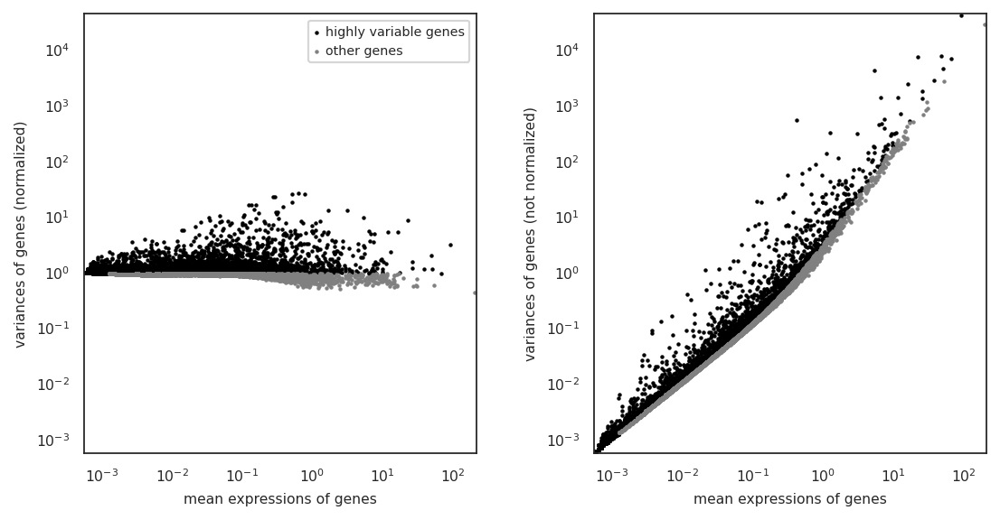

In [43]:
sc.pl.highly_variable_genes(adata, log=True, show=None, save=None, highly_variable_genes=True)

In [44]:
adata

AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'neighbors', 'pca', 'tsne', 'umap', 'hvg'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'connectivities', 'distances'

## add marker genes to highly variable

In [45]:
if add_marker_genes ==True:
    marker_genes_df = pd.read_csv(marker_gene_path, encoding='latin-1', index_col='gene_name')

In [46]:
#limit to human only
marker_genes_df = marker_genes_df[marker_genes_df['species'] == 'homo_sapiens']
marker_genes_df

,ENSEMBL_Gene,uniprot_ID,protein_name,species,protein_cytoplasm,protein_intracellular,protein_membrane,protein_nucleus,protein_secretory,cytokine,...,viral_entry_positive_reg_evidence,class,notes,UniProtID,UniProt_summary,citation,total_seq_A,total_seq_B,total_seq_C,last_curator
gene_name,,,,,,,,,,,,,,,,,,,,,
ACKR4,ENSG00000129048,NaN,NaN,homo_sapiens,NaN,False,True,False,False,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ACOD1,ENSG00000102794,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,wallet
ACTA1,ENSG00000143632,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ACTA2,ENSG00000107796,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
ADAR,NaN,NaN,NaN,homo_sapiens,NaN,False,False,True,False,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,wallet
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZEB2,ENSG00000169554,O60315,NaN,homo_sapiens,NaN,True,False,NaN,False,False,...,NaN,marker,NaN,NaN,NaN,https://doi.org/10.1111/imm.12888,FALSE,False,False,wallet
CNTF,ENSG00000242689,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CNTFR,ENSG00000122756,NaN,NaN,homo_sapiens,NaN,NaN,NaN,NaN,NaN,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [47]:
#limit to markers used for distinguishing immune from tumor cells
marker_genes_df = marker_genes_df[marker_gene_sets]

In [48]:
marker_genes_df

,M_important_marker,DC_important_marker
gene_name,,
ACKR4,NaN,NaN
ACOD1,True,False
ACTA1,NaN,NaN
ACTA2,NaN,NaN
ADAR,False,False
...,...,...
ZEB2,True,False
CNTF,NaN,NaN
CNTFR,NaN,NaN


In [49]:
#extract gene names
marker_lists = []
for i in marker_gene_sets:
    marker_genes_list = list(set(marker_genes_df[marker_genes_df[i]==True].index))
    marker_lists.append(marker_genes_list)
marker_lists

[['SCARA5',
  'IL12B',
  'S100A15',
  'THBD',
  'HLA-DMA',
  'C5AR1',
  'ITGAM',
  'CEBPA',
  'LILRB4',
  'C1R',
  'SCARF2',
  'EPCAM',
  'CLEC7A',
  'CD226',
  'CXCL10',
  'TPSD1 ',
  'HLA-DRB4',
  'ELANE',
  'CD274',
  'CD5',
  'CD55',
  'CADM1',
  'CD1A',
  'PDCD1',
  'PTGDR',
  'SCARF1',
  'CD86',
  'SOD2',
  'CD8A',
  'CFI',
  'MASP1',
  'GRN',
  'MNDA',
  'PDCD1LG2',
  'CD209',
  'IFNG',
  'LILRA2',
  'HLA-DRA',
  'PIK3CA',
  'SPI1',
  'STAB1',
  'S100A8',
  'CLEC4A',
  'AHR',
  'CTSK',
  'CTSG',
  'SSC5D',
  'GPX4',
  'XCR1',
  'DPP4',
  'COLEC12',
  'TACE',
  'TNFRSF21',
  'CD80',
  'CD2',
  'LRP1',
  'SECISBP2L',
  'S100A9',
  'NOTCH2',
  'VTCN1',
  'MARCO',
  'VASP',
  'CFH',
  'GPX1',
  'ENPP3',
  'CD74',
  'ACOD1',
  'FCRLS',
  'ZBTB46 ',
  'C3',
  'CR1',
  'MPO',
  'ID2',
  'CD14',
  'IRF7',
  'CSF2RA',
  'MBL2',
  'SCARA3',
  'KLF4',
  'ARG1',
  'STAB2',
  'TACSTD2',
  'GPX5',
  'SIGLEC6',
  'GPX7',
  'CD68',
  'LY75',
  'IL12RB1',
  'CD24',
  'CD1C',
  'HLA-DRB3',
  'CX3

In [50]:
#concatenate lists
import itertools
a = marker_lists
marker_genes = list(itertools.chain.from_iterable(a))
marker_genes

['SCARA5',
 'IL12B',
 'S100A15',
 'THBD',
 'HLA-DMA',
 'C5AR1',
 'ITGAM',
 'CEBPA',
 'LILRB4',
 'C1R',
 'SCARF2',
 'EPCAM',
 'CLEC7A',
 'CD226',
 'CXCL10',
 'TPSD1 ',
 'HLA-DRB4',
 'ELANE',
 'CD274',
 'CD5',
 'CD55',
 'CADM1',
 'CD1A',
 'PDCD1',
 'PTGDR',
 'SCARF1',
 'CD86',
 'SOD2',
 'CD8A',
 'CFI',
 'MASP1',
 'GRN',
 'MNDA',
 'PDCD1LG2',
 'CD209',
 'IFNG',
 'LILRA2',
 'HLA-DRA',
 'PIK3CA',
 'SPI1',
 'STAB1',
 'S100A8',
 'CLEC4A',
 'AHR',
 'CTSK',
 'CTSG',
 'SSC5D',
 'GPX4',
 'XCR1',
 'DPP4',
 'COLEC12',
 'TACE',
 'TNFRSF21',
 'CD80',
 'CD2',
 'LRP1',
 'SECISBP2L',
 'S100A9',
 'NOTCH2',
 'VTCN1',
 'MARCO',
 'VASP',
 'CFH',
 'GPX1',
 'ENPP3',
 'CD74',
 'ACOD1',
 'FCRLS',
 'ZBTB46 ',
 'C3',
 'CR1',
 'MPO',
 'ID2',
 'CD14',
 'IRF7',
 'CSF2RA',
 'MBL2',
 'SCARA3',
 'KLF4',
 'ARG1',
 'STAB2',
 'TACSTD2',
 'GPX5',
 'SIGLEC6',
 'GPX7',
 'CD68',
 'LY75',
 'IL12RB1',
 'CD24',
 'CD1C',
 'HLA-DRB3',
 'CX3CR1',
 'FCGR3B',
 'RAGE',
 'SCARB2',
 'GPX8',
 'TNFSF9',
 'CD22',
 'PVR',
 'TNFSF11',
 'TPSB

In [51]:
#set important marker genes as highly variable

for i in marker_genes:
    if i in adata.var_names:
        adata.var['highly_variable'][i]= True
    else:
        print(i, 'not found')

IL12B not found
S100A15 not found
SCARF2 not found
TPSD1  not found
HLA-DRB4 not found
MASP1 not found
TACE not found
ENPP3 not found
ACOD1 not found
FCRLS not found
ZBTB46  not found
MBL2 not found
ARG1 not found
STAB2 not found
GPX5 not found
HLA-DRB3 not found
RAGE not found
C8A not found
CEACAM8 not found
CSF2 not found
GPX6 not found
C9 not found
NOS2 not found
C4B not found
C4A not found
FCGR2C not found
SRCRB4D not found
MEGF10 not found
ENPP3 not found
ZBTB46  not found
FCGR2C not found


/scratch/lsftmp/14418965.tmpdir/ipykernel_811754/2651330476.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var['highly_variable'][i]= True


In [52]:
adata[:,'FASLG'].var['highly_variable']

FASLG    True
Name: highly_variable, dtype: bool

## cluster

## PCA neighbors clustering imputation

In [53]:
adata.X

array([[0.69035184, 0.        , 1.1553309 , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.0223384 , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.5196656 , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.9468794 , 0.        ,
        0.9468794 ],
       [0.        , 0.        , 0.7664873 , ..., 0.        , 0.        ,
        0.        ]], dtype=float32)

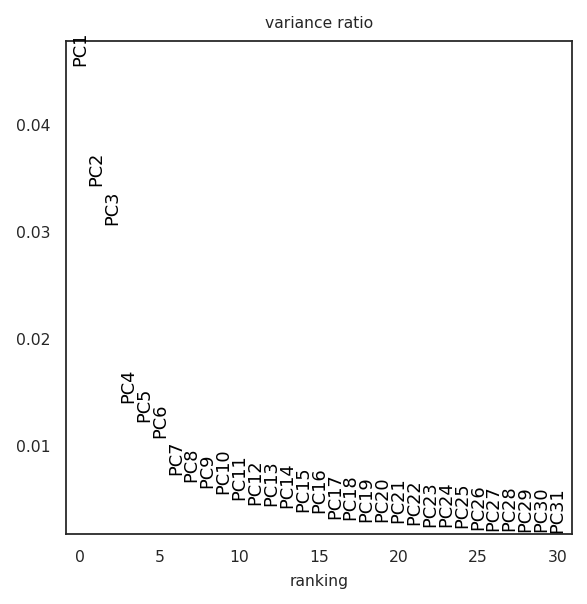

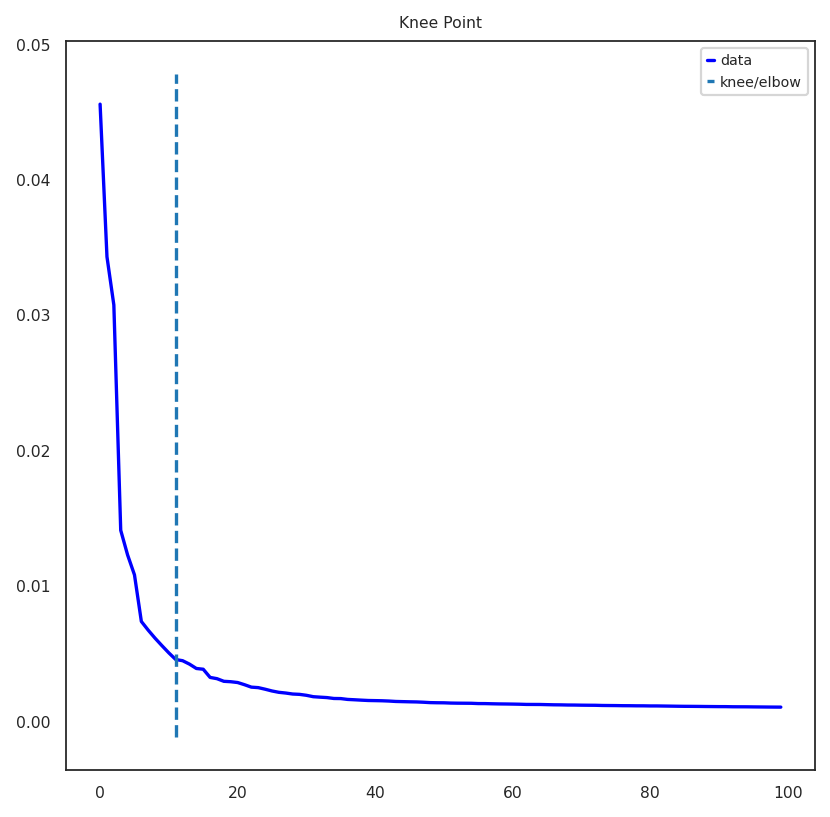

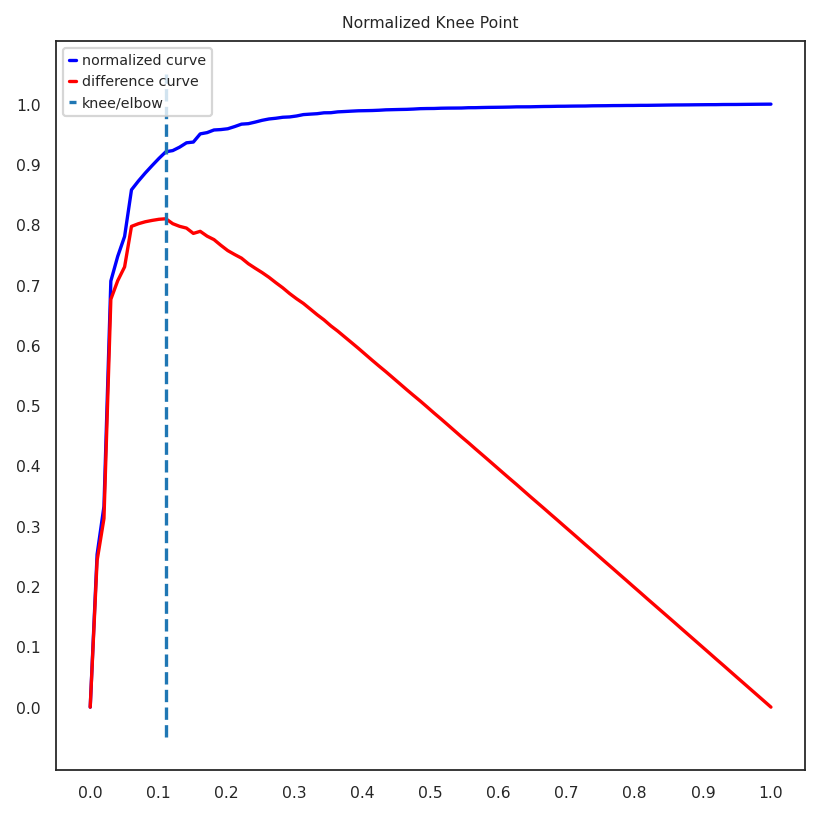

Kneepoint happens at PC: 11
11 PC explain 17.85835805349052 % of variance
2 PC explain 7.9880740493535995 % of variance
3 PC explain 11.062182858586311 % of variance
4 PC explain 12.471747677773237 % of variance
5 PC explain 13.698992785066366 % of variance
6 PC explain 14.779182989150286 % of variance
7 PC explain 15.515025053173304 % of variance
8 PC explain 16.186372563242912 % of variance
9 PC explain 16.798193380236626 % of variance
10 PC explain 17.3549288418144 % of variance
11 PC explain 17.85835805349052 % of variance
12 PC explain 18.312948290258646 % of variance
13 PC explain 18.75880886800587 % of variance
14 PC explain 19.179335609078407 % of variance
15 PC explain 19.56777989398688 % of variance
16 PC explain 19.950550165958703 % of variance
17 PC explain 20.27294198051095 % of variance
18 PC explain 20.585962594486773 % of variance
19 PC explain 20.879561896435916 % of variance
20 PC explain 21.17012704256922 % of variance
21 PC explain 21.45479521714151 % of variance
22

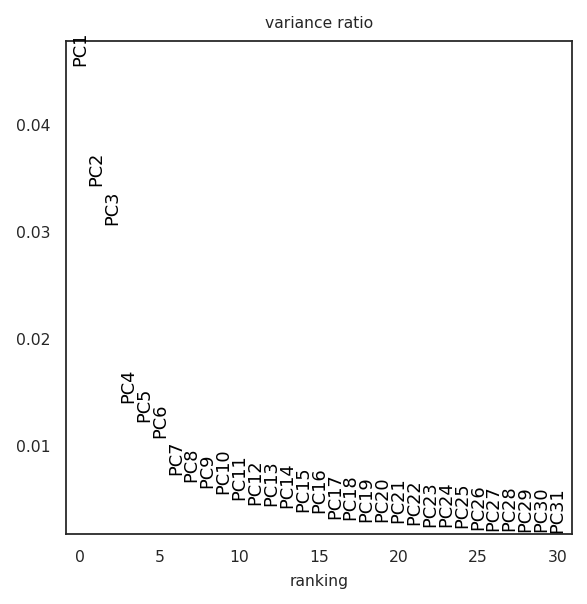

In [54]:
#select optimal number of PCs and recalculate PCs
number_of_PC_used = calculate_optimal_PC(adata, min_PC = 50, min_var=25, n_comps=100, use_hv=None)

In [55]:
sc.pp.neighbors(adata, n_neighbors=10, method= 'umap', n_pcs=number_of_PC_used)
sc.tl.umap(adata)

In [56]:
sc.tl.tsne(adata, random_state = 7, n_pcs=number_of_PC_used)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:795: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(


In [57]:
adata

AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'neighbors', 'pca', 'tsne', 'umap', 'hvg'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'raw'
    obsp: 'connectivities', 'distances'

In [58]:
for j,k in enumerate(pheno_names):
        result_pheno_ndf_all = sce.tl.phenograph(adata.obsm['X_pca'], k = pheno_k[j],seed=1)
        adata.obs[k] = pd.Categorical(result_pheno_ndf_all[0])

Finding 10 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 7.729885101318359 seconds
Jaccard graph constructed in 6.766621351242065 seconds
Wrote graph to binary file in 0.06319212913513184 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.881518
Louvain completed 21 runs in 2.6117374897003174 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 21.77805733680725 seconds
Finding 20 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 8.287497520446777 seconds
Jaccard graph constructed in 8.549222230911255 seconds
Wrote graph to binary file in 0.15067291259765625 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.833755
After 5 runs, maximum modularity is Q = 0.835023
Louvain completed 25 runs in 5.2479047775268555 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 27.319053411483765 seconds
Fi

In [39]:
a = magic(adata, copy=True, verbose=True, solver= 'exact', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = a.X

Calculating MAGIC...
  Running MAGIC on 17023 cells and 16682 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 0.64 seconds.
  Calculated graph and diffusion operator in 0.65 seconds.
Calculated MAGIC in 0.74 seconds.


KeyboardInterrupt: 

### save data

In [40]:
#indicate save path
adata_save_path

'/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered_v2_230125.h5ad'

In [41]:
#save data
adata.write(adata_save_path)
print('adata written to', adata_save_path)

adata written to /data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered_v2_230125.h5ad



# plot results


# plot results

In [3]:
#standard variables
TNK_suffix = '_TNK'
B_suffix = '_Bcell'
M_suffix = '_myeloid'

#pheno_names = ['pheno_M_k10', 'pheno_M_k20', 'pheno_M_k30', 'pheno_M_k40', 'pheno_M_k50', 'pheno_M_k60',
 #             'pheno_M_k70','pheno_M_k80','pheno_M_k90','pheno_M_k100']
pheno_names = ['pheno_var_M_k10', 'pheno_var_M_k20', 'pheno_var_M_k30', 'pheno_var_M_k40', 'pheno_var_M_k50', 'pheno_M_k60',
              'pheno_var_M_k70','pheno_var_M_k80','pheno_var_M_k90','pheno_var_M_k100']
continue_with_adata = False

#set variables
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_5000hv_clustered_v2_230125.h5ad'
#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_clustered_v2_230125.h5ad'

markers_plot_M = ['CD68','MRC1','CD14','ID2','TCF4','IRF4','IRF8','IRF7','BATF3','FUT4','CD207','LY6G','CSF3R','TPSAB1','TPSB2','HDC','FUT4','VASP','CSF3R','ACOD1','FFAR4','LY6G','MPO','CTSG','LTF']
markers_plot_TNK = ['CD3D','CD3E','CD3G','CD4','CD8A','TRAC','TRBC1','TRGC1','TRDC','IL2RA','FOXP3','CCR7','SELL','CD27','CD28','CD69','ITGAL','CXCR3','IL2RB','CD58','CD57','NCR1','KLRB1C','PRF1','THY1','IL7R','EOMES','TBX21','IL1R2','CD200R1','TRAIL','ITGA1','ICOS','KLRG1','GATA3','RORA','AHR','TNFSF11','RORC','KIT','ITGA4','IL1R1','IL33']
markers_plot_B = ['MS4A1','CD19','CD27','SDC1','IGHG1','IGHG2B','IGHG2C','IGHG3','IGHA','IGHE','IGHD','IGHM','MKI67']
markers_plot = markers_plot_M

In [4]:
#load subset files
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [5]:
#randomize cells for plotting
adata = randomize_cells(adata)

In [6]:
# Filter out genes not present in single cell data
marker_genes_filtered = []
for marker in markers_plot:
    if marker in adata.var.index:   
        marker_genes_filtered.append(marker)
    else:
        print(marker + ' filtered out')
marker_genes_filtered = list(set(marker_genes_filtered))

LY6G filtered out
ACOD1 filtered out
LY6G filtered out


In [7]:
adata.obs

,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,batch,primary_tumor,...,pheno_var_M_k10,pheno_var_M_k20,pheno_var_M_k30,pheno_var_M_k40,pheno_var_M_k50,pheno_M_k60,pheno_var_M_k70,pheno_var_M_k80,pheno_var_M_k90,pheno_var_M_k100
239946733402413-T12,960,6.867974,1790.155640,7.490616,13.340266,23.134549,37.570166,64.802282,T12,True,...,18,14,14,14,14,16,0,0,0,1
231897697008932-T23,731,6.595781,1361.135498,7.216809,14.330059,23.584603,38.065763,73.056855,T23,True,...,22,1,2,1,2,2,4,6,4,5
122428805466348-T11,1300,7.170888,1909.007080,7.554862,11.795769,20.388274,32.483736,56.501023,T11,True,...,16,12,7,13,13,7,5,2,2,3
166290890804013-T23,1293,7.165493,1742.650635,7.463736,11.189330,18.249432,29.074054,52.004442,T23,True,...,26,19,17,17,17,8,15,9,1,0
196113282811828-T15,1401,7.245655,2005.773438,7.604283,12.340938,21.805012,34.261433,56.137687,T15,True,...,10,9,3,3,2,3,3,4,5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
156933486169500-T21,1412,7.253470,1891.939575,7.545886,11.575743,19.523100,31.373767,55.322666,T21,True,...,15,13,12,12,11,8,10,9,10,10
166469266262428-T09,859,6.756932,1598.833496,7.377655,12.263055,20.883332,35.137624,65.212264,T09,True,...,2,7,4,5,5,4,6,2,2,3
205511430884187-T21,1231,7.116394,1904.954956,7.552739,11.583463,20.352925,33.337907,57.092847,T21,True,...,18,14,14,14,14,16,0,0,0,1
239468515548587-T16,2110,7.654917,2009.801270,7.606288,10.696030,17.979483,29.026983,49.744883,T16,True,...,16,13,12,13,11,8,10,9,10,10



# plot results

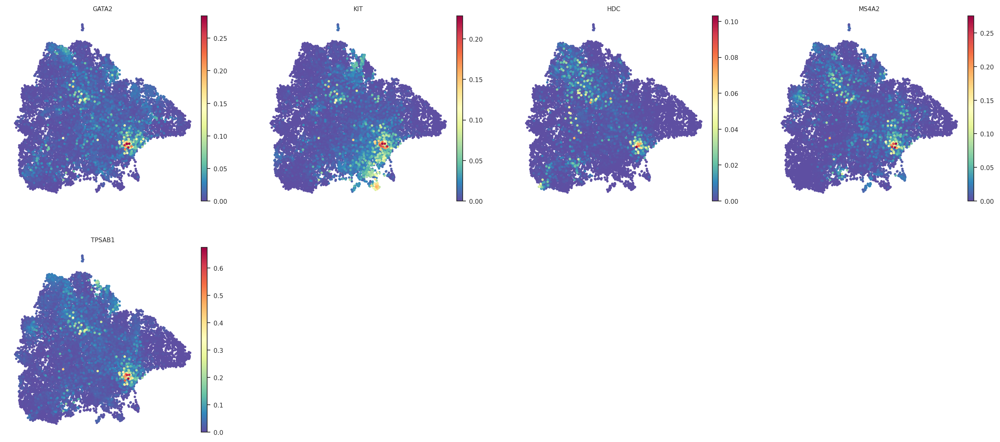

In [8]:
sc.pl.umap(adata, color = ['GATA2','KIT','HDC','MS4A2','TPSAB1'], s = 30, cmap='Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0)


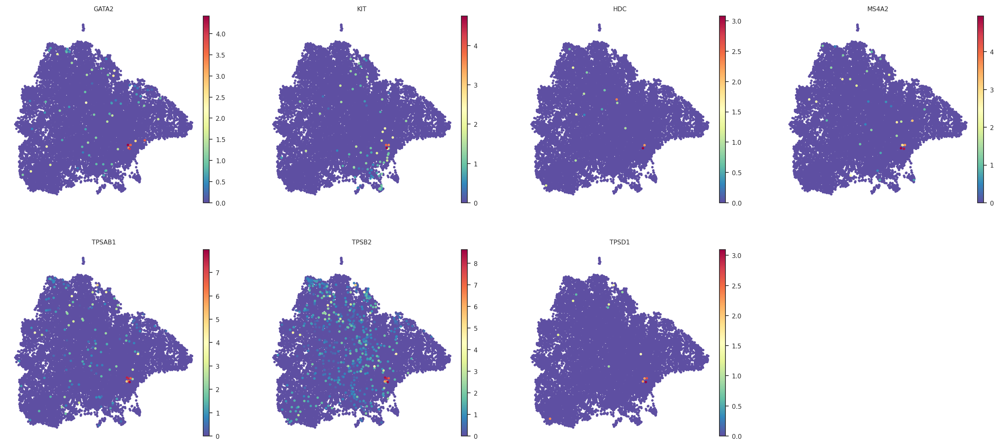

In [9]:
sc.pl.umap(adata, color = ['GATA2','KIT','HDC','MS4A2','TPSAB1','TPSB2','TPSD1'], s = 30, cmap='Spectral_r', layer=None, legend_fontsize = 10, vmin=0)


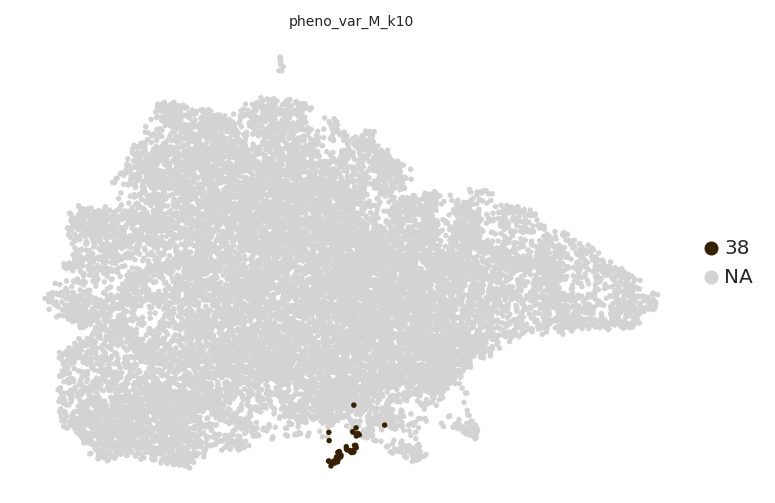

In [66]:
sc.pl.umap(adata, color = ['pheno_var_M_k10'], groups=[38],s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0, vmax=10000)


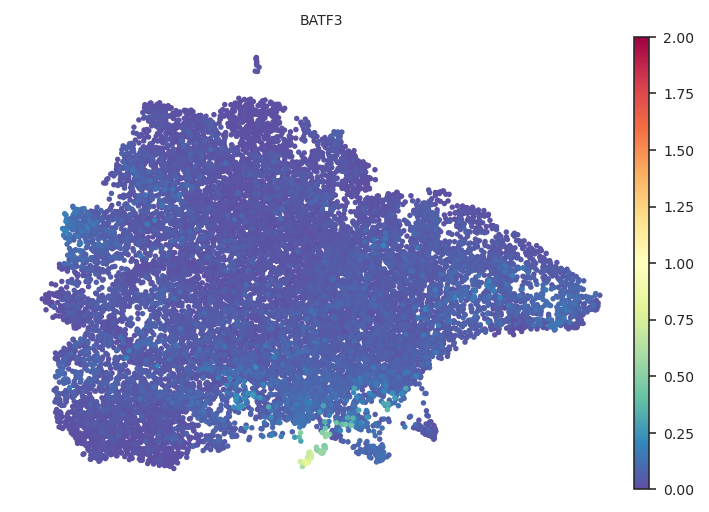

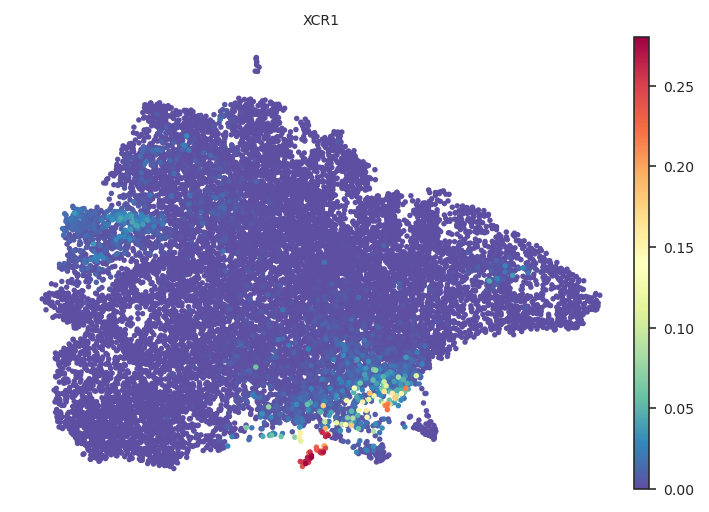

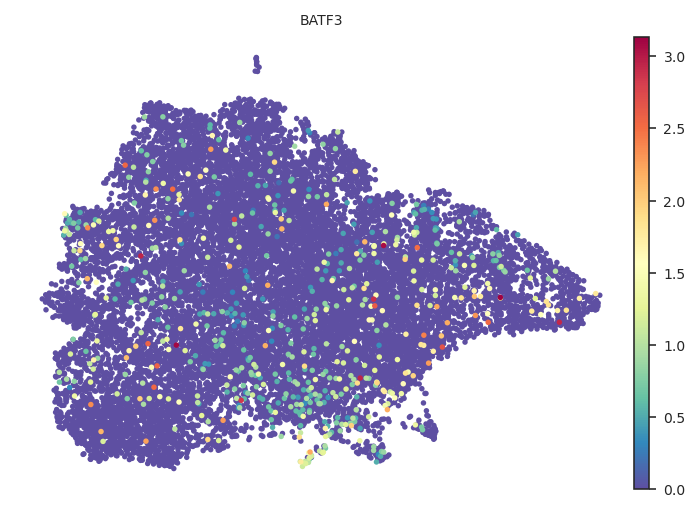

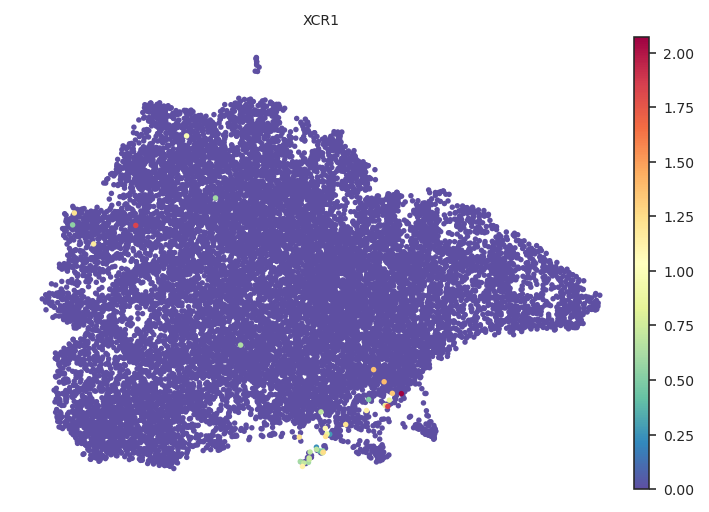

In [63]:
sc.pl.umap(adata, color = ['BATF3'], s = 30, cmap='Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0,vmax=2)
sc.pl.umap(adata, color = ['XCR1'], s = 30, cmap='Spectral_r', layer='imputed', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['BATF3'], s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['XCR1'], s = 30, cmap='Spectral_r',legend_fontsize = 10, vmin=0)

In [11]:
adata.obs['primary_tumor'] = pd.Categorical(adata.obs['primary_tumor'])

/scratch/lsftmp/18647109.tmpdir/ipykernel_414644/1944174019.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['primary_tumor'] = pd.Categorical(adata.obs['primary_tumor'])


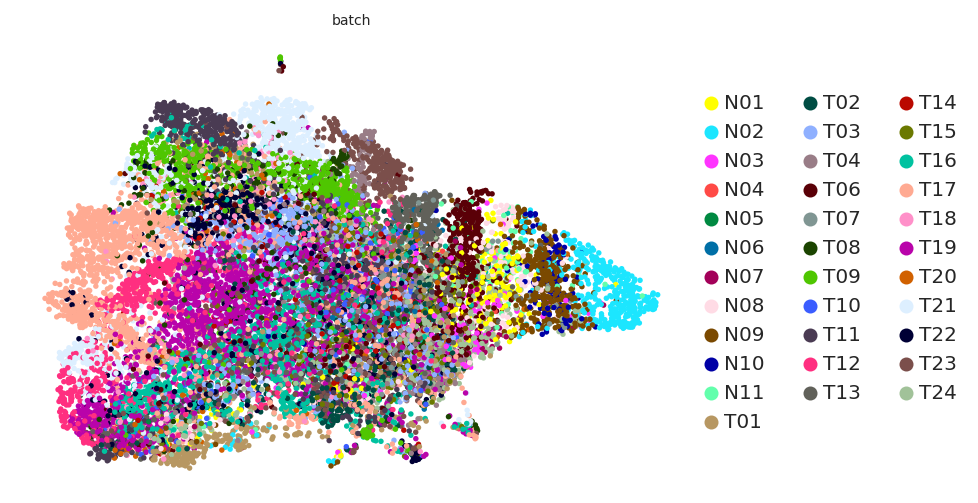

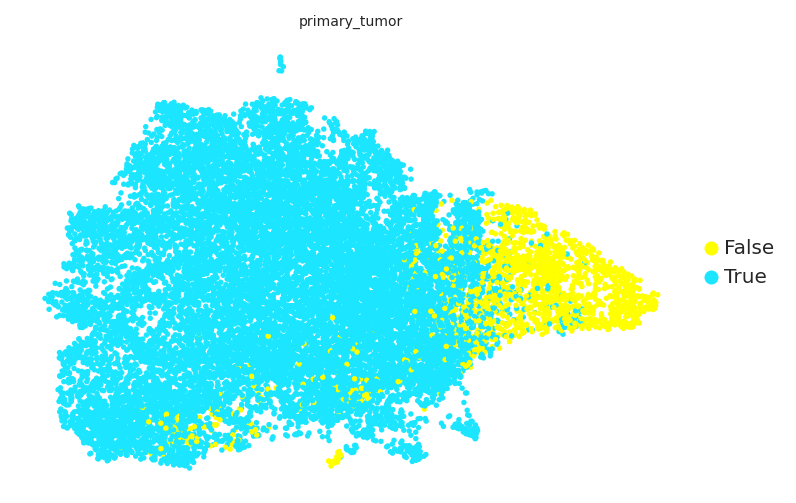

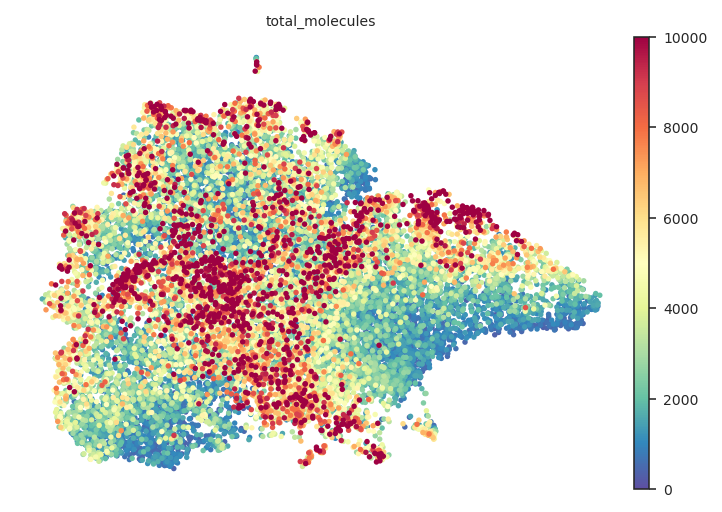

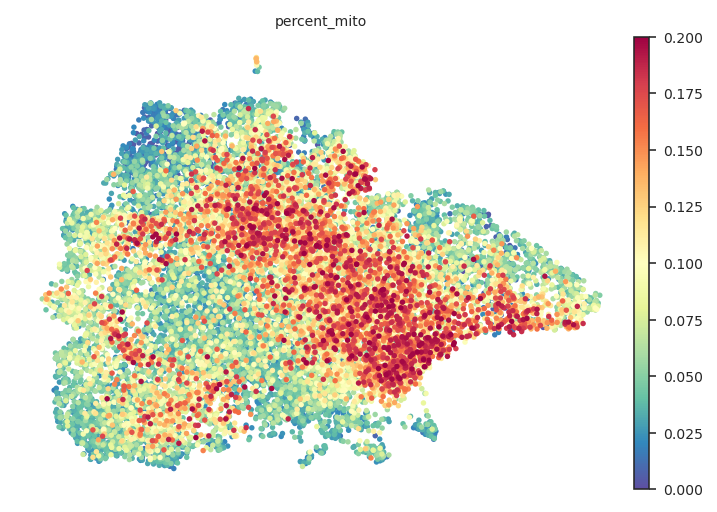

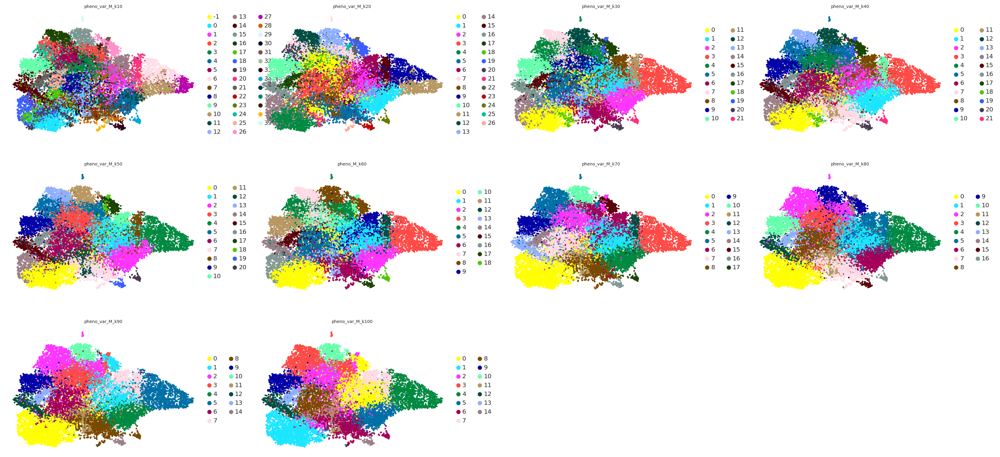

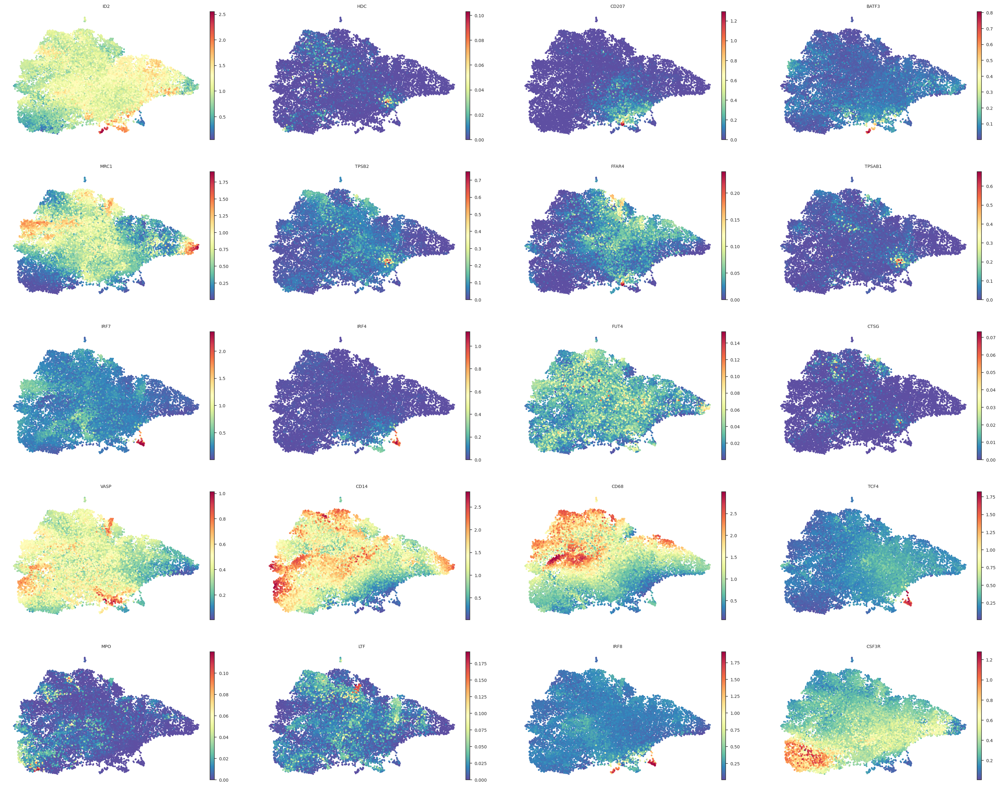

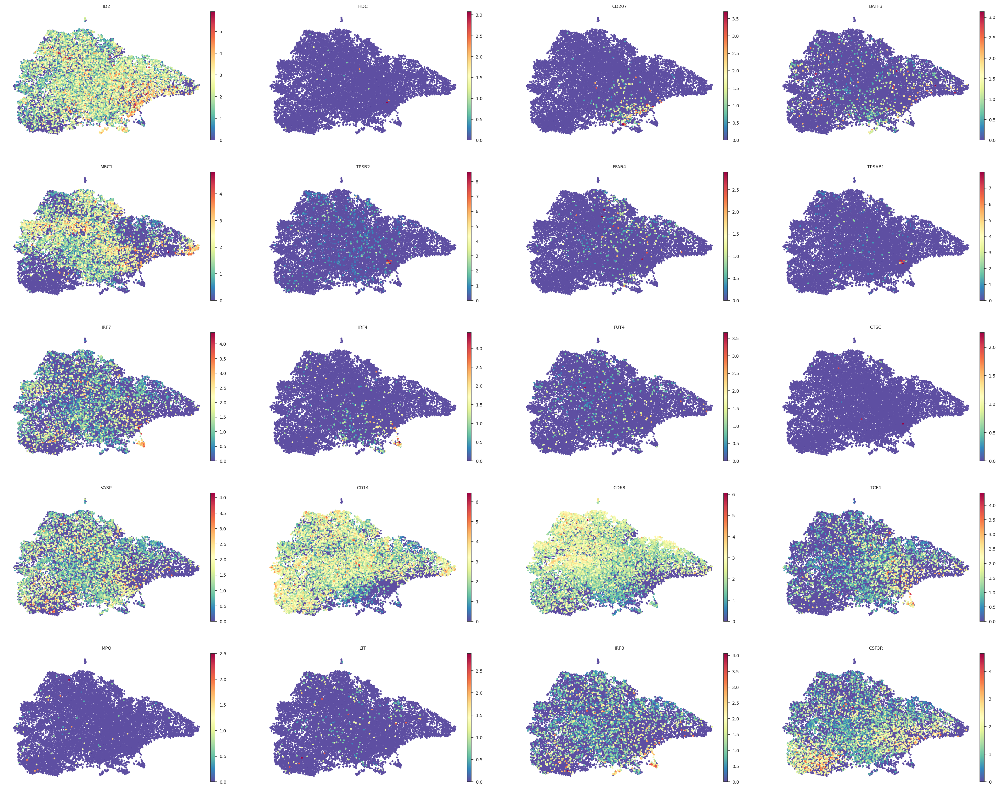

In [15]:
### plot cell subsets
%matplotlib inline
sns.set_style('white')

sc.pl.umap(adata, color = ['batch'], s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['primary_tumor'], s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = ['total_molecules'], s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0, vmax=10000)
sc.pl.umap(adata, color = ['percent_mito'], s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = pheno_names, s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)
sc.pl.umap(adata, color = marker_genes_filtered,  layer = 'imputed', s = 30, cmap= 'Spectral_r', legend_fontsize = 10)
sc.pl.umap(adata, color = marker_genes_filtered,  layer = None, s = 30, cmap= 'Spectral_r', legend_fontsize = 10)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list


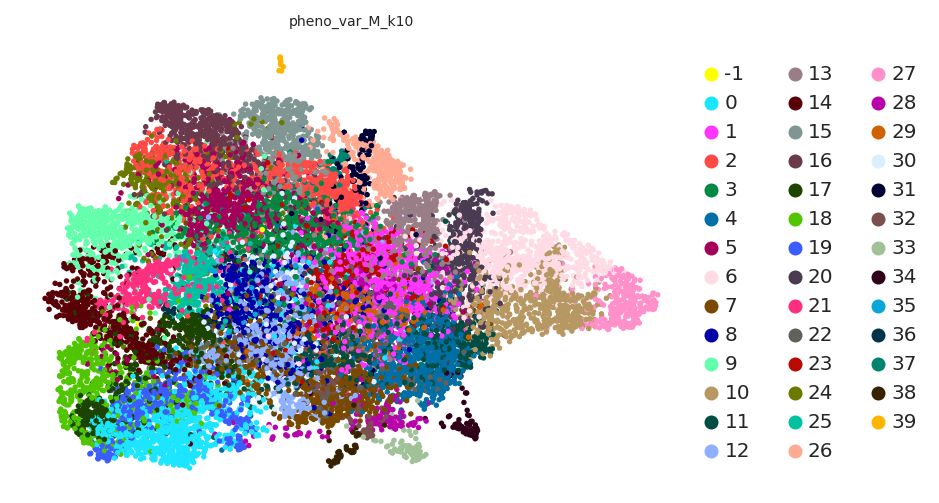

In [16]:
#bootstrap 10000 cells from adata to avoid int overflow,if adata < 100 000 cells use all cells

if len(adata.obs_names) > 100000:
    adata_sample = adata[adata.obs.sample(n=100000, replace=False, random_state=1, axis=0).index,:]
else:
    adata_sample = adata

In [22]:
#if you get overflow error that means that the calculation intermediate results are too big to store into np.int64
#this messes up the entire calculatation so you have to downsample the cells
rand_indices = pd.DataFrame(index=pheno_names, columns=pheno_names)

for i in pheno_names:
    for j in pheno_names:
        a = np.int64(np.array(adata_sample.obs[i]))
        b = np.int64(np.array(adata_sample.obs[j]))
        c = adjusted_rand_score(a, b)
        rand_indices.loc[i,j] = c

In [23]:
rand_indices

,pheno_var_M_k10,pheno_var_M_k20,pheno_var_M_k30,pheno_var_M_k40,pheno_var_M_k50,pheno_M_k60,pheno_var_M_k70,pheno_var_M_k80,pheno_var_M_k90,pheno_var_M_k100
pheno_var_M_k10,1.0,0.453714,0.419393,0.418494,0.405396,0.380188,0.341,0.342707,0.322678,0.314215
pheno_var_M_k20,0.453714,1.0,0.581726,0.600926,0.557743,0.509484,0.468701,0.48756,0.448045,0.482093
pheno_var_M_k30,0.419393,0.581726,1.0,0.784935,0.713354,0.732155,0.6092,0.596827,0.589991,0.565066
pheno_var_M_k40,0.418494,0.600926,0.784935,1.0,0.783956,0.74282,0.658969,0.638259,0.631188,0.604182
pheno_var_M_k50,0.405396,0.557743,0.713354,0.783956,1.0,0.747912,0.686928,0.691821,0.681704,0.675592
pheno_M_k60,0.380188,0.509484,0.732155,0.74282,0.747912,1.0,0.722395,0.677726,0.674465,0.6479
pheno_var_M_k70,0.341,0.468701,0.6092,0.658969,0.686928,0.722395,1.0,0.760818,0.763811,0.733799
pheno_var_M_k80,0.342707,0.48756,0.596827,0.638259,0.691821,0.677726,0.760818,1.0,0.805037,0.799657
pheno_var_M_k90,0.322678,0.448045,0.589991,0.631188,0.681704,0.674465,0.763811,0.805037,1.0,0.827479
pheno_var_M_k100,0.314215,0.482093,0.565066,0.604182,0.675592,0.6479,0.733799,0.799657,0.827479,1.0


<AxesSubplot:>

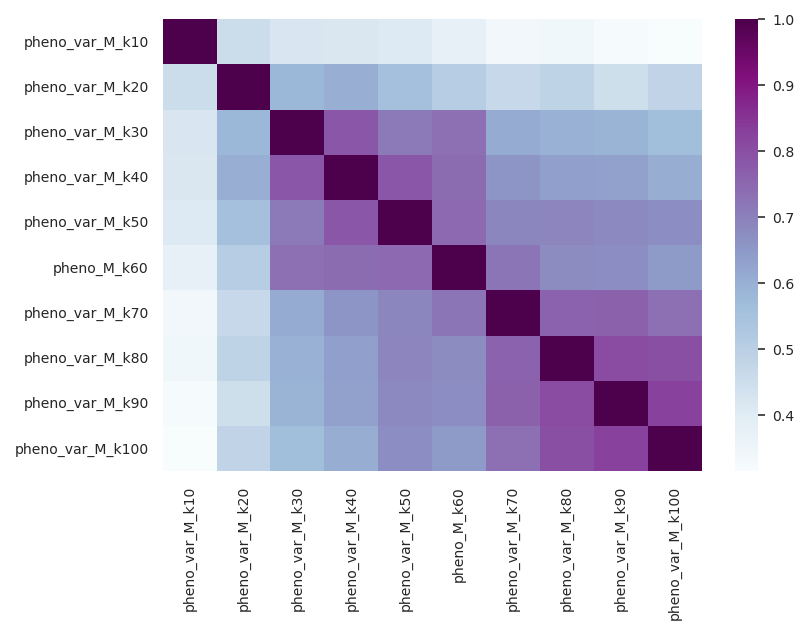

In [24]:
#plot rand indices
sns.heatmap(rand_indices.astype('float'),
                    cmap='BuPu',
                    cbar=True,
                    yticklabels=True,
                    xticklabels=True,
                  # vmax=1,
                   # center=0.5,
                    #vmin=0)
            )

# typing heatmaps

In [8]:
#define adata, clusters and marker genes for heatmaps here
adata_typing_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_5000hv_clustered_v2_230125.h5ad'
pheno_heat = 'pheno_var_M_k30'
continue_with_adata = False

#define marker genes
load_marker_genes = True
marker_genes_path = '/data/peer/wallet/Jupyter/PDAC_RT_Huber_Walle/PDAC_Lowe_TILC_markers.csv' #path of marker gene csv file with gene column
gene_column_name = 'gene_name' #name of column in csv file where gene names are located

#define visualization parameters
layer_heat_imputed = True
z_score_cluster = False
cluster_minus_one_present = False #when PhenoGraph cannot put cells into a cluster it will label these cells with -1, if this is True these cells will not be plotted in the heatmaps
z_score_cells = True #if True gene expression will be z scored across cells and average z score per cluster will be calculated, if false average gene expression per cluster will be calculated and z scored across clusters


In [9]:
##### load marker genes

if load_marker_genes ==True:
    marker_genes_df = pd.read_csv(marker_genes_path)
    ##add additional genes of interest here
    #extract gene names and combine lists
    marker_genes = list(marker_genes_df.loc[:,gene_column_name])
    marker_genes = marker_genes 
    marker_genes = list(set(marker_genes))
else:
    marker_genes = list(set(marker_genes_custom))
        

In [10]:
marker_genes_df

,uniprot_ID,Uniprot_ID2,ENSEMBL_Gene,gene_name
0,NaN,NaN,ENSMUSG00000023274,CD4
1,NaN,NaN,ENSMUSG00000053977,CD8A
2,NaN,NaN,ENSMUSG00000059498,FCGR3
3,P05555,NaN,ENSG00000169896,ITGAM
4,NaN,NaN,ENSMUSG00000001444,TBX21
...,...,...,...,...
156,NaN,NaN,ENSMUSG00000066755,TNFSF18
157,NaN,NaN,ENSMUSG00000041272,TOX
158,NaN,NaN,ENSMUSG00000027298,TYRO3
159,F6TUL9,F6TUL9,ENSMUSG00000044206,VSIG4


In [11]:
#load anndata
if continue_with_adata == False:
    adata = sc.read(adata_typing_path)
adata

AnnData object with n_obs × n_vars = 17023 × 16682
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'batch', 'primary_tumor', 'Limited', 'PValue_emptydrops', 'FDR_emptydrops', 'total_molecules', 'percent_mito', 'pheno_var_k10', 'pheno_var_k20', 'pheno_var_k30', 'pheno_var_k40', 'pheno_var_k50', 'pheno_var_k60', 'pheno_var_k70', 'pheno_var_k80', 'pheno_var_k90', 'pheno_var_k100', 'major_subsets', 'pheno_var_M_k10', 'pheno_var_M_k20', 'pheno_var_M_k30', 'pheno_var_M_k40', 'pheno_var_M_k50', 'pheno_M_k60', 'pheno_var_M_k70', 'pheno_var_M_k80', 'pheno_var_M_k90', 'pheno_var_M_k100'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'hvg', 'neighbors', 'pca',

In [12]:
# Filter out genes not present in single cell data
marker_genes_filtered = []
for marker in marker_genes:
    if marker in adata.var.index:   
        marker_genes_filtered.append(marker)
    else:
        print(marker + ' filtered out')

KLRB1C filtered out
IL13 filtered out
LY6A filtered out
IL22 filtered out
IL17B filtered out
IL9 filtered out
IL6RA filtered out
IL23R filtered out
IL17F filtered out
H2-AB1 filtered out
KLRA3 filtered out
H2-OB filtered out
B3GAT1 filtered out
IL21 filtered out
GAL3ST2 filtered out
VSIR filtered out
KLRA9 filtered out
FCGR3 filtered out
HA2B filtered out
CD8B1 filtered out
FCER2A filtered out
HAVCR1 filtered out
IL4 filtered out
PTGDR2 filtered out
CCR9 filtered out
IL5 filtered out
TNFRSF9  filtered out


In [13]:
marker_genes_filtered

['TNF',
 'BCL6',
 'CCR7',
 'IL17RA',
 'CXCL12',
 'PDCD1',
 'TNFRSF10B',
 'VSIG4',
 'CD84',
 'IFNG',
 'CXCL10',
 'IL7R',
 'SELL',
 'CCR2',
 'NR4A2',
 'CD69',
 'TRBC1',
 'MERTK',
 'TOX',
 'CD70',
 'EOMES',
 'KIT',
 'CD160',
 'IL17RE',
 'NCR1',
 'CD28',
 'CD36',
 'CXCR3',
 'CD200R1',
 'KLRC2',
 'TNFSF18',
 'CD27',
 'CD4',
 'CD3G',
 'SOCS1',
 'RORA',
 'CD38',
 'ATXN1',
 'PDGFRA',
 'CXCL11',
 'BTLA',
 'NKG7',
 'IL13RA1',
 'IL17A',
 'ITGAM',
 'PRF1',
 'CBLB',
 'TBX21',
 'TNFRSF18',
 'KLRC1',
 'IL21R',
 'CD226',
 'GZMK',
 'IFNGR1',
 'TNFRSF14',
 'IL1R1',
 'LAG3',
 'LAYN',
 'TGFB1',
 'IL17RB',
 'CX3CL1',
 'IL12RB1',
 'CCR10',
 'CD96',
 'CXCR4',
 'CCR4',
 'IL1R2',
 'HNF1A',
 'CTLA4',
 'CXCL1',
 'CD274',
 'GATA3',
 'TRAC',
 'TYRO3',
 'IL1RL1',
 'S1PR1',
 'TNFRSF4',
 'IL2RB',
 'NR4A1',
 'XCR1',
 'ENTPD1',
 'TRDC',
 'TNFSF10',
 'ICOS',
 'ITGA2',
 'NT5E',
 'TRBC2',
 'CXCL16',
 'S1PR5',
 'NR4A3',
 'CD3D',
 'KLRD1',
 'CCR6',
 'IL2',
 'FAS',
 'ITGA1',
 'CXCL9',
 'THY1',
 'IL10',
 'ITGA5',
 'TRGC1',
 '

In [14]:
if z_score_cells == False and z_score_cluster == False:
    
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
    
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float') 
    
    ## select imputed or raw layer 
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(
        adata.layers['imputed'], index=adata.obs_names, columns=adata.var_names)
    else:
        gene_expression_zscored = pd.DataFrame(
        adata.X, index=adata.obs_names, columns=adata.var_names)

    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)
            
    %matplotlib inline
    
    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)
    
    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score
    
    # set color scale
    divnorm = colors.DivergingNorm(vmin=-1, vcenter=0, vmax=1)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 2) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(50,10), vmax=3, z_score= False, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

In [43]:
if z_score_cells == True and z_score_cluster == False:   
    
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
        
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float')
 
    ## select imputed or raw layer   
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(scipy.stats.zscore(adata.layers['imputed'],axis=0), index=adata.obs_names, columns=adata.var_names) # create zscored gene expression df
    else:
        gene_expression_zscored = pd.DataFrame(scipy.stats.zscore(adata.X, axis=0), index=adata.obs_names, columns=adata.var_names)
        
    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)

    %matplotlib inline

    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any',subset=None, inplace=False)

    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score

    # set color scale
    divnorm = colors.DivergingNorm(vmin=-2, vcenter=0, vmax=2)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 2) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(100,40), vmax=3, z_score=None, vmin=-3) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

Cluster:  0
Cluster:  1
Cluster:  2
Cluster:  3
Cluster:  4
Cluster:  5
Cluster:  6
Cluster:  7
Cluster:  8
Cluster:  9
Cluster:  10
Cluster:  11
Cluster:  12
Cluster:  13
Cluster:  14
Cluster:  15
Cluster:  16
Cluster:  17
Cluster:  18
Cluster:  19
Cluster:  20
Cluster:  21


type: module 'matplotlib.colors' has no attribute 'DivergingNorm'

In [44]:
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(100,40), vmax=3, z_score=None, vmin=-3) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

In [45]:
if z_score_cluster ==True and z_score_cluster == False:
    ## calculate means for each cluster and export to dataframe
    all_cells_df_clean = adata.obs[pheno_heat] 
    clusters_cells_clean = list(set(all_cells_df_clean.values))
    
    ## remove -1 cells not belonging to any cluster
    if cluster_minus_one_present == True:
        clusters_cells_clean.remove(-1) #optional if -1 in heatmap
    
    ## create empty dataframe
    marker_df = pd.DataFrame(index=clusters_cells_clean, columns=marker_genes_filtered)
    marker_df = marker_df.astype('float') 
    
    ## select imputed or raw layer 
    if layer_heat_imputed == True:
        gene_expression_zscored = pd.DataFrame(
        adata.layers['imputed'], index=adata.obs_names, columns=adata.var_names)
    else:
        gene_expression_zscored = pd.DataFrame(
        adata.X, index=adata.obs_names, columns=adata.var_names)

    for i in clusters_cells_clean:
        print('Cluster: ',i)
        cluster_adata = all_cells_df_clean[all_cells_df_clean==i]
        cluster_adata2 = gene_expression_zscored.loc[cluster_adata.index, :]
        for j in marker_genes_filtered:
            marker_df.loc[i,:] = np.mean(cluster_adata2, axis=0)
            
    %matplotlib inline
    
    # drop na columns
    marker_df = marker_df.dropna(axis=1, how='any', thresh=None, subset=None, inplace=False)
    
    # drop all zero columns
    non_zero = (marker_df != 0).any(axis=0)
    marker_df = marker_df[non_zero.index[non_zero]]#drop zeros columns bc SD will be 0 --> cant divide with 0 for z score
    
    # set color scale
    divnorm = colors.DivergingNorm(vmin=-1, vcenter=0, vmax=1)
    marker_df = marker_df.astype(float) #  gene expression means x pheno cluster matrix
    sns.set(font_scale = 2) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib
    sns.clustermap(marker_df, cmap='bwr', col_cluster=True, figsize=(50,10), vmax=3, z_score= 1, norm=divnorm) # if error matplotlib has no attribute DivergingNorm appears update Matplotlib

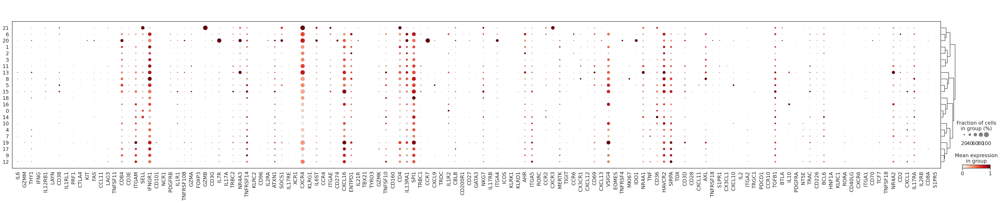

In [46]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, marker_genes_filtered, groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [69]:
import cytopus as cp

In [97]:
G = cp.kb.KnowledgeBase()

KnowledgeBase object containing 75 cell types and 201 cellular processes



In [71]:
G.identities.keys()

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

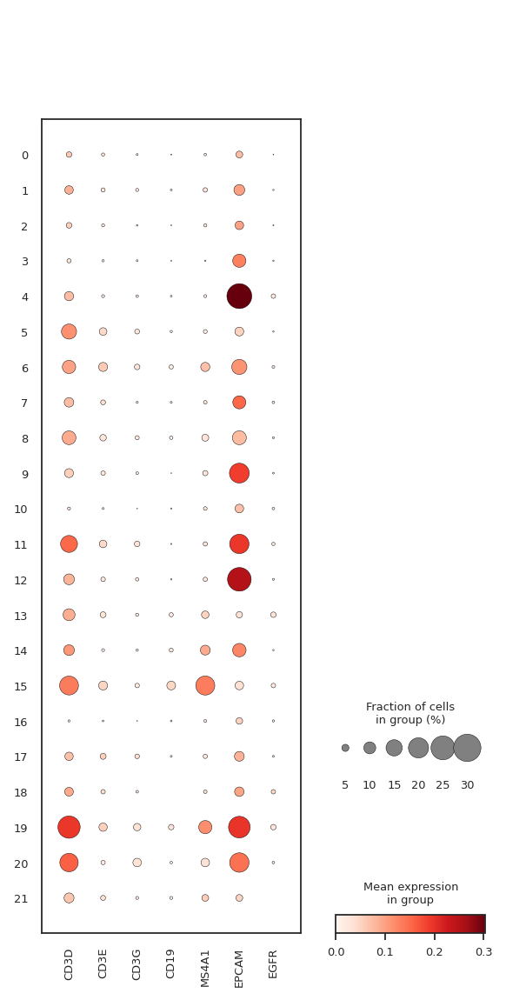

In [40]:
genes_of_interest = ['CD3D','CD3E','CD3G','CD19','MS4A1','EPCAM','EGFR']

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale=None)

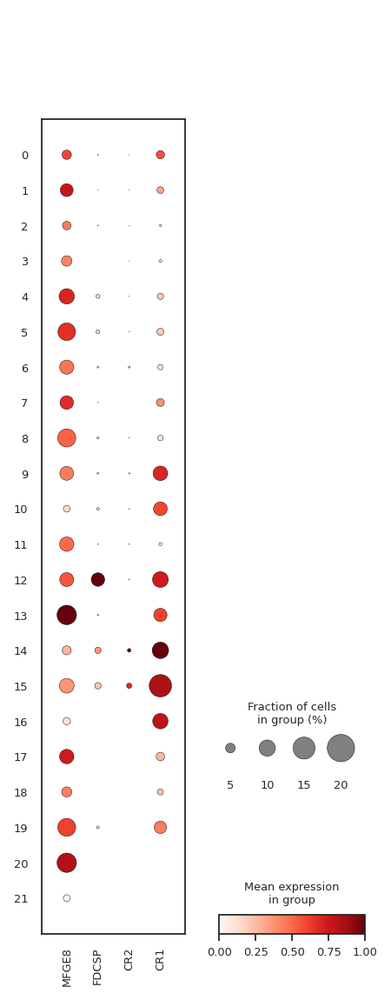

In [26]:
genes_of_interest = list(G.identities['FDC'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

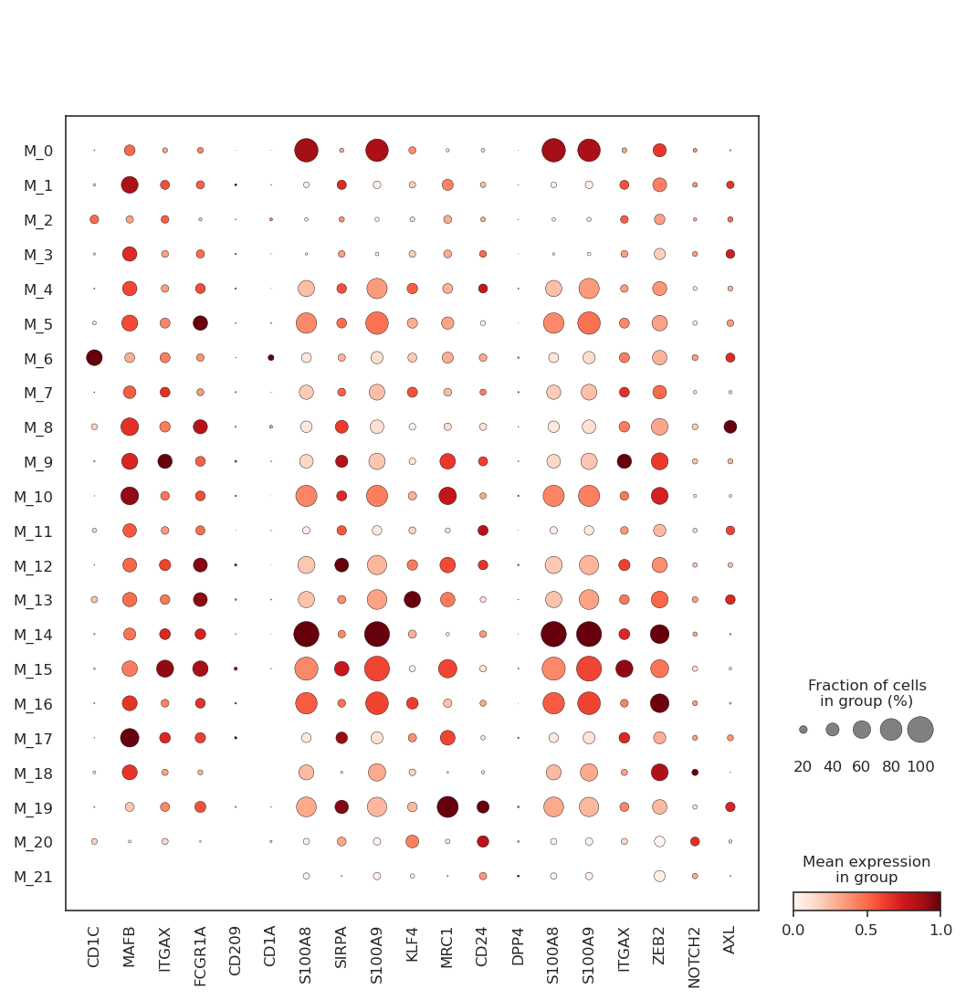

In [98]:
genes_of_interest = list(G.identities['mo-DC'])+['CD24','DPP4','S100A8','S100A9','ITGAX', 'ZEB2', 'NOTCH2', 'AXL']

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

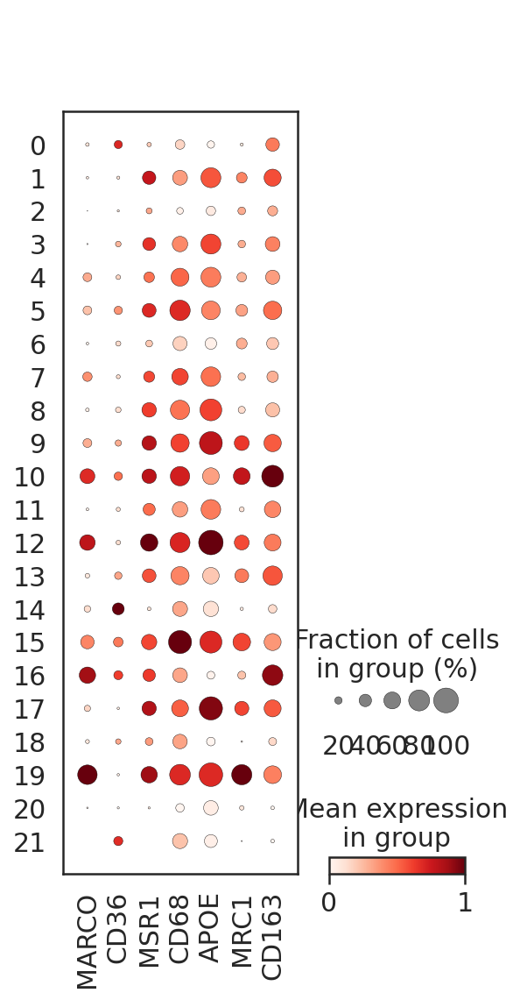

In [72]:
genes_of_interest = list(G.identities['Mac'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

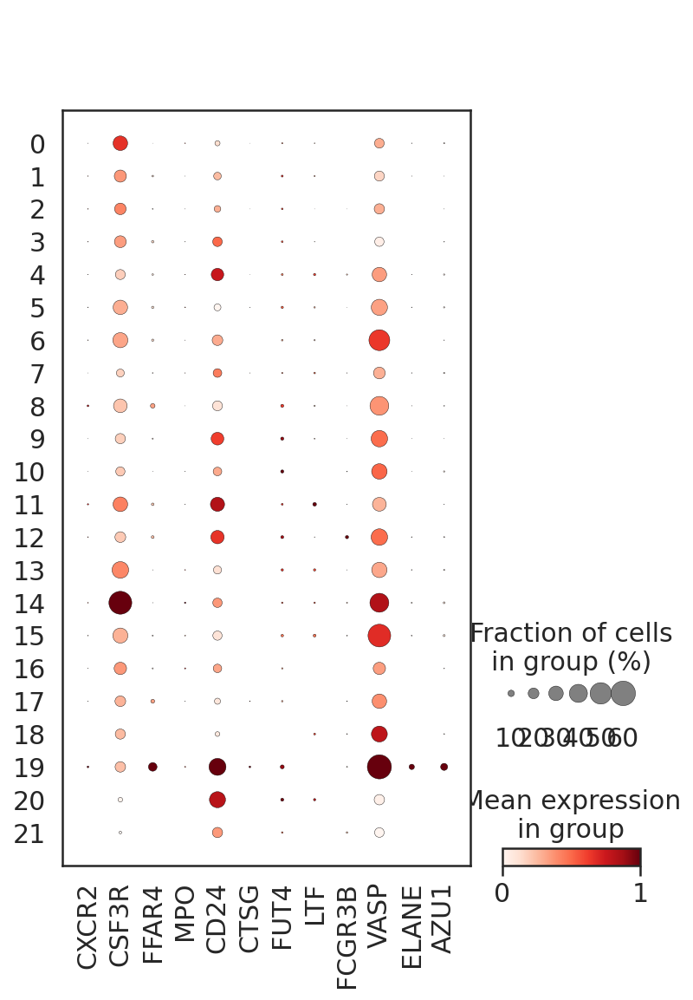

In [71]:
genes_of_interest = list(G.identities['gran'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

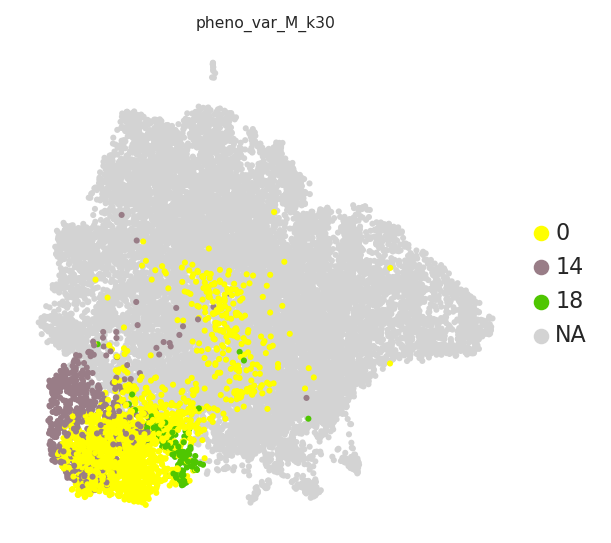

In [20]:
sc.pl.umap(adata, color = pheno_heat, groups=[0,14,18],s = 30, palette=color_map_clusters, legend_fontsize = 10, vmin=0)


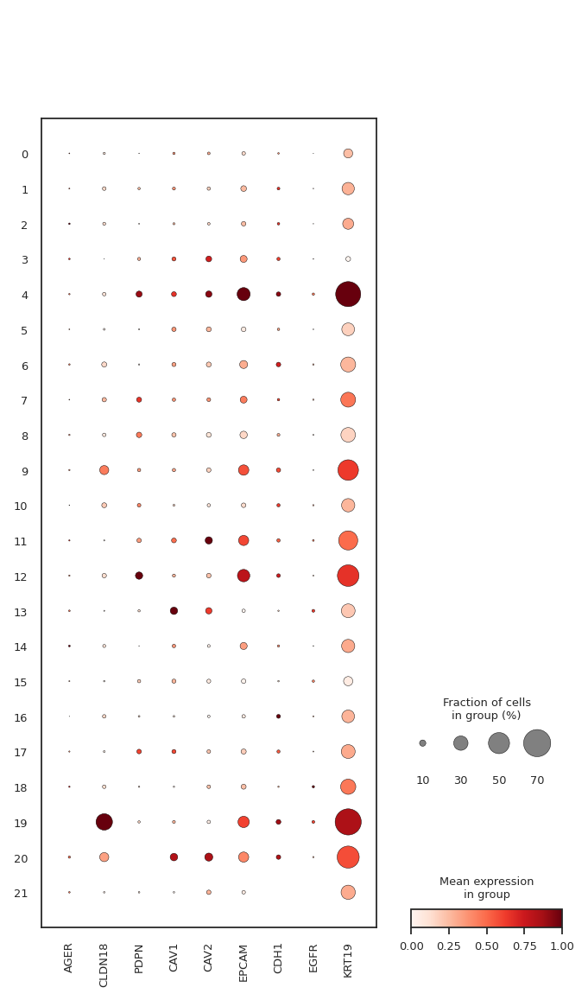

In [19]:
genes_of_interest = ['AGER', 'CLDN18', 'PDPN', 'CAV1', 'CAV2', 'EPCAM', 'CDH1', 'EGFR', 'KRT19']

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

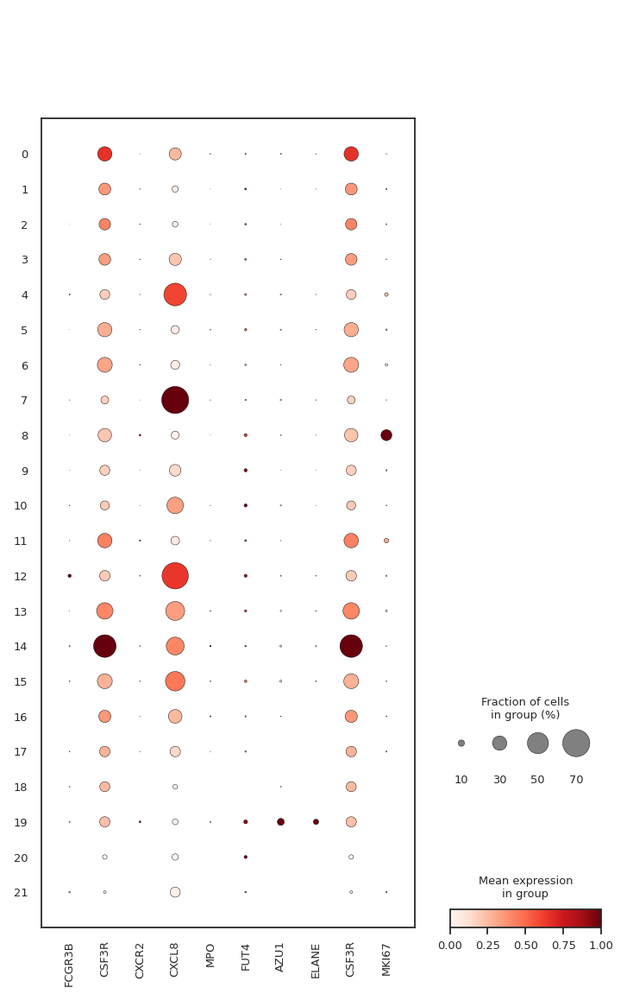

In [30]:
genes_of_interest = ['FCGR3B', 'CSF3R', 'CXCR1', 'CXCR2', 'CXCL8',
                    'MPO', 'FUT4', 'CEACAM8', 'AZU1', 'ELANE', 'CSF3R', 'MKI67']

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

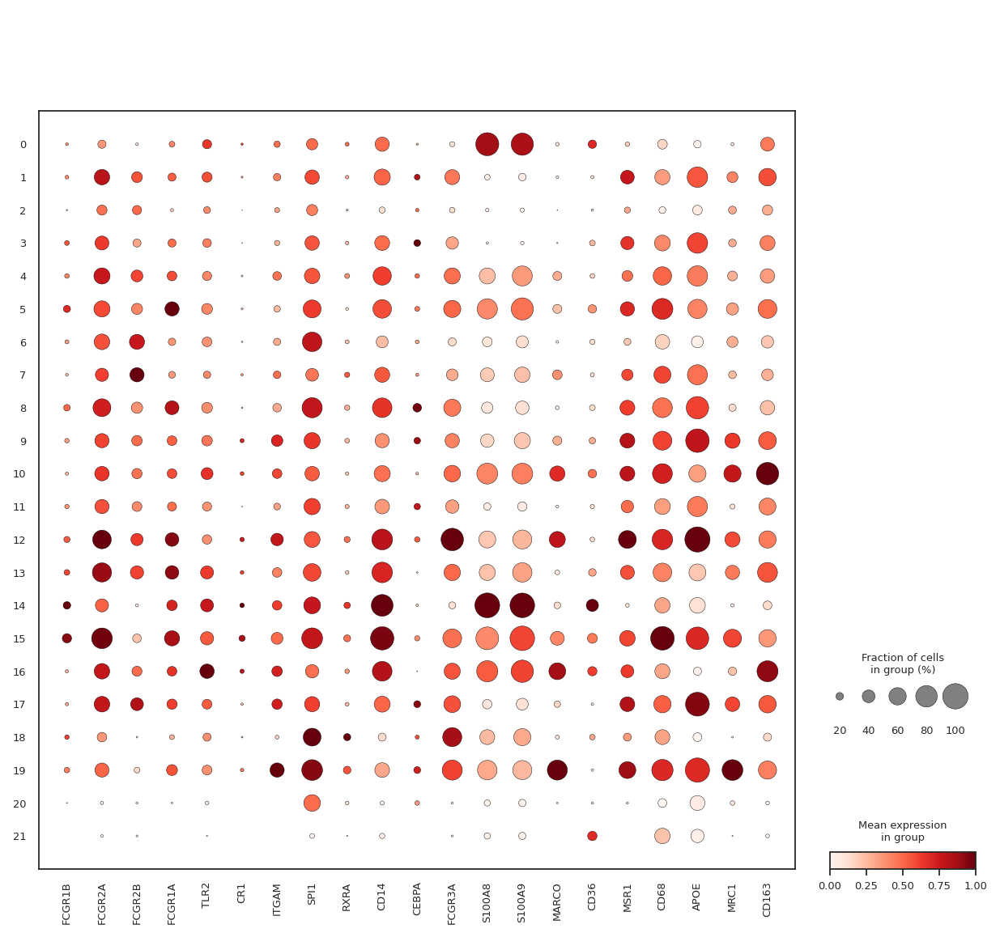

In [17]:
genes_of_interest = list(G.identities['mono']) + ['FCGR3A','S100A8','S100A9'] +list(G.identities['Mac'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

In [35]:
TAM_MK_like = ['TIRCG1', 'CD109', 'CD151', 'SDC1', 'CLEC4A', 'CD68', 'ITGB3', 'CST3']
TR_Mac = ['TCIRG1','CD109','ITGB3','CD151','SDC1','CLEC4A']
PV_Mac = [ 'LYVE1', 'FOLR2', 'SELENOP', 'STAB1', 'F13A1', 'DAB2', 'MAF', 'RNASE1']

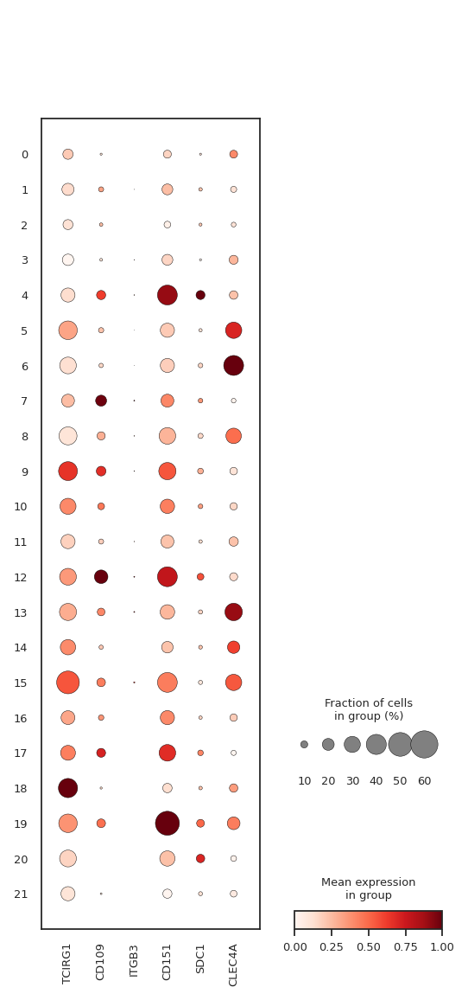

In [34]:
genes_of_interest = TR_Mac
genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

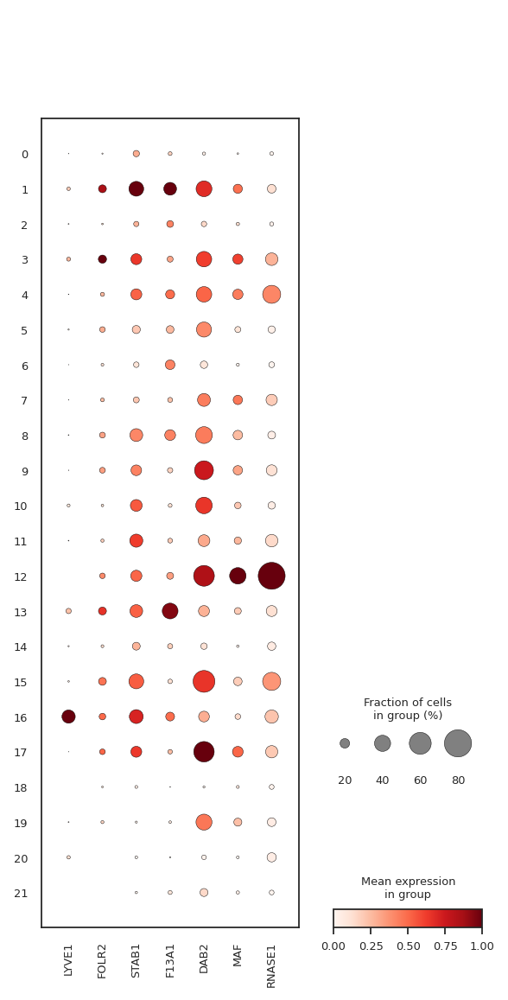

In [37]:
genes_of_interest = PV_Mac 

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

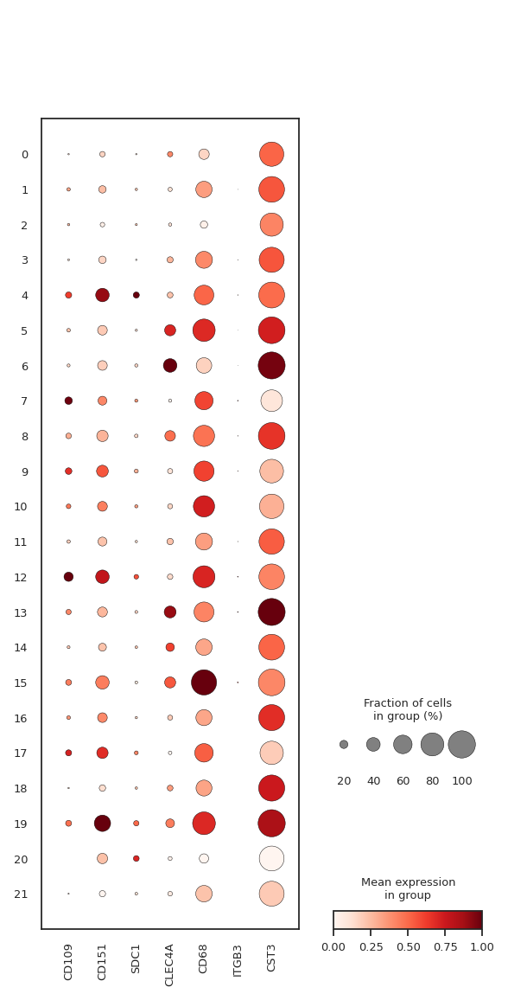

In [33]:
genes_of_interest = TAM_MK_like

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

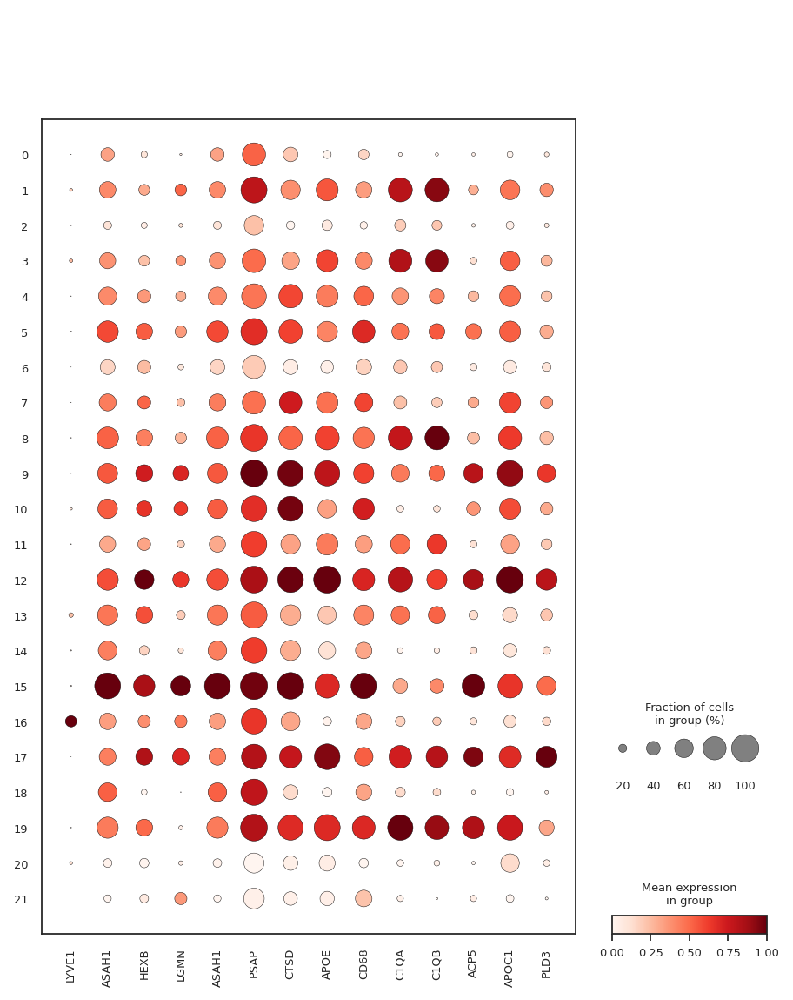

In [26]:
genes_of_interest = TAM_VMac
genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

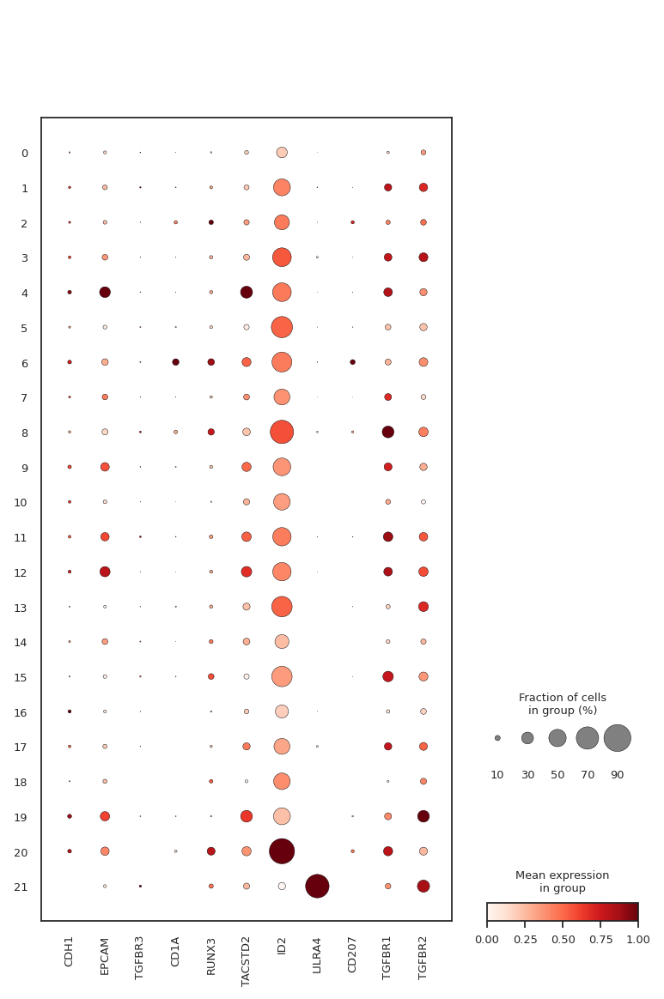

In [18]:
genes_of_interest = list(G.identities['Langerhans'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

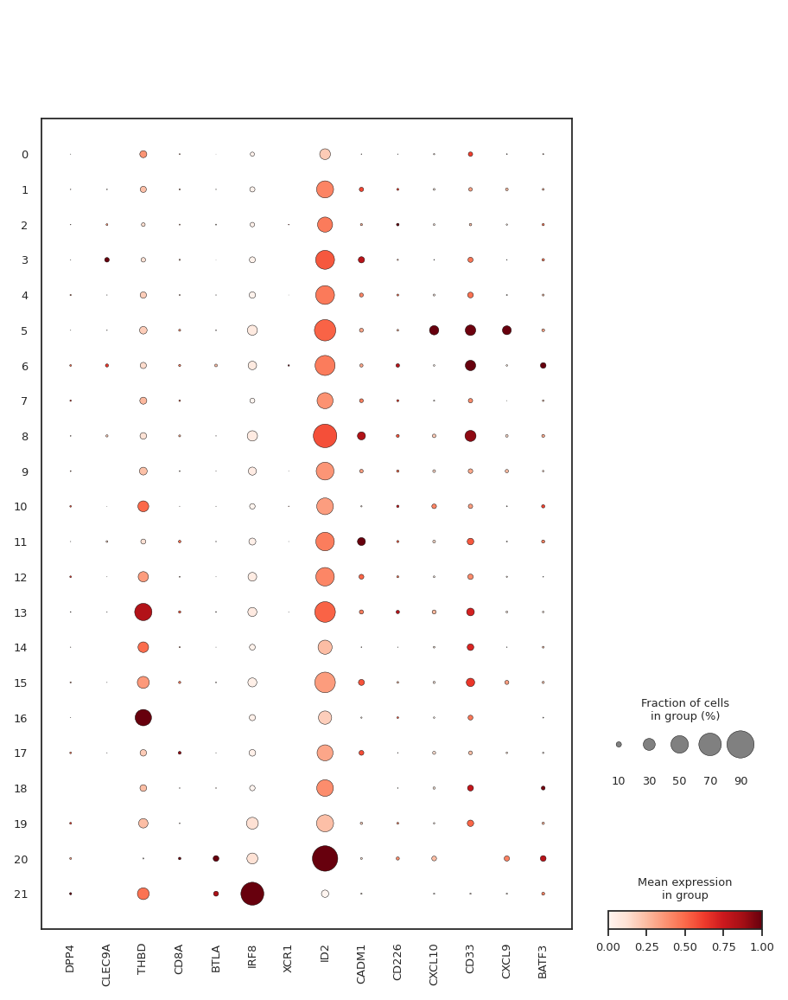

In [32]:
genes_of_interest = list(G.identities['cDC1'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

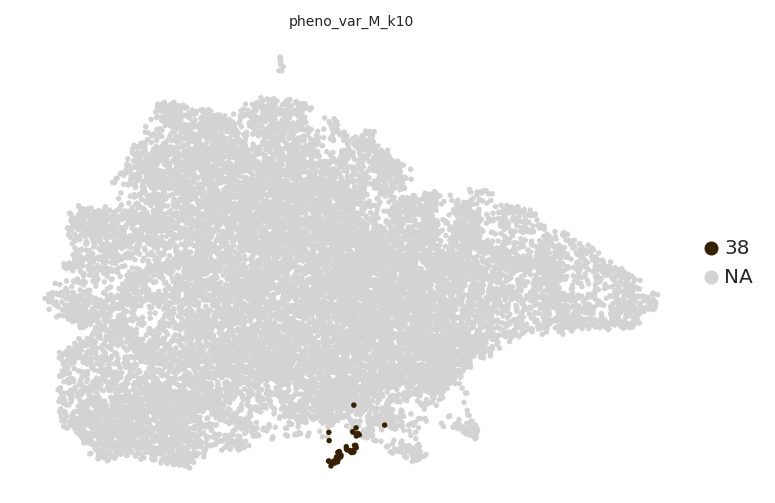

In [67]:
sc.pl.umap(adata, color = ['pheno_var_M_k10'], groups=[38],s = 30, cmap='Spectral_r', legend_fontsize = 10, vmin=0, vmax=10000)


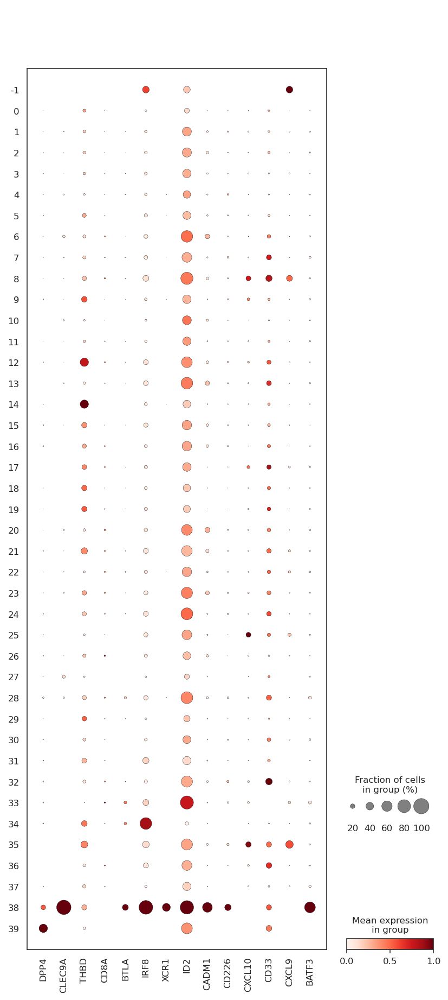

In [72]:
genes_of_interest = list(G.identities['cDC1'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby='pheno_var_M_k10', dendrogram=False, standard_scale='var')

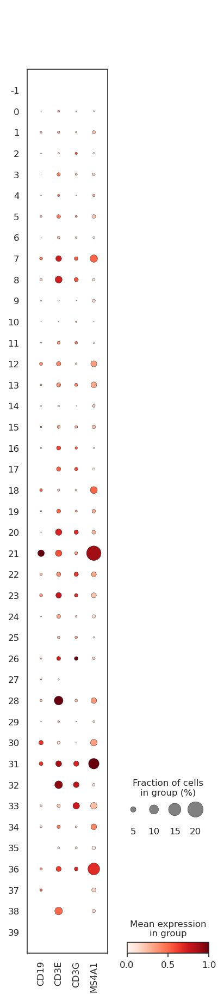

In [75]:
genes_of_interest = ['CD19','CD3E','CD3G','MS4A1']
genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby='pheno_var_M_k10', dendrogram=False, standard_scale='var')

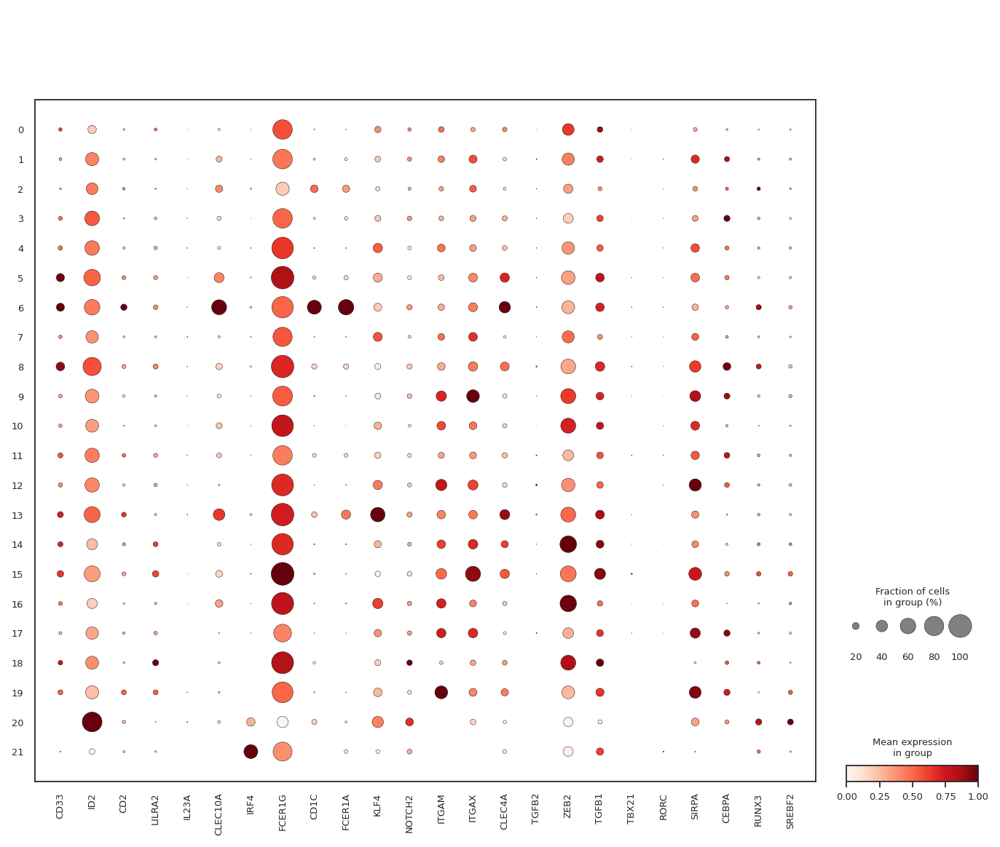

In [33]:
genes_of_interest = list(G.identities['cDC2']) + ['TBX21','RORC','SIRPA','CEBPA','RUNX3','SREBF2']

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

In [96]:
genes_of_interest = list(G.identities['cDC3'])+['AXL']

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

type: 'hierarchy' object has no attribute 'identities'

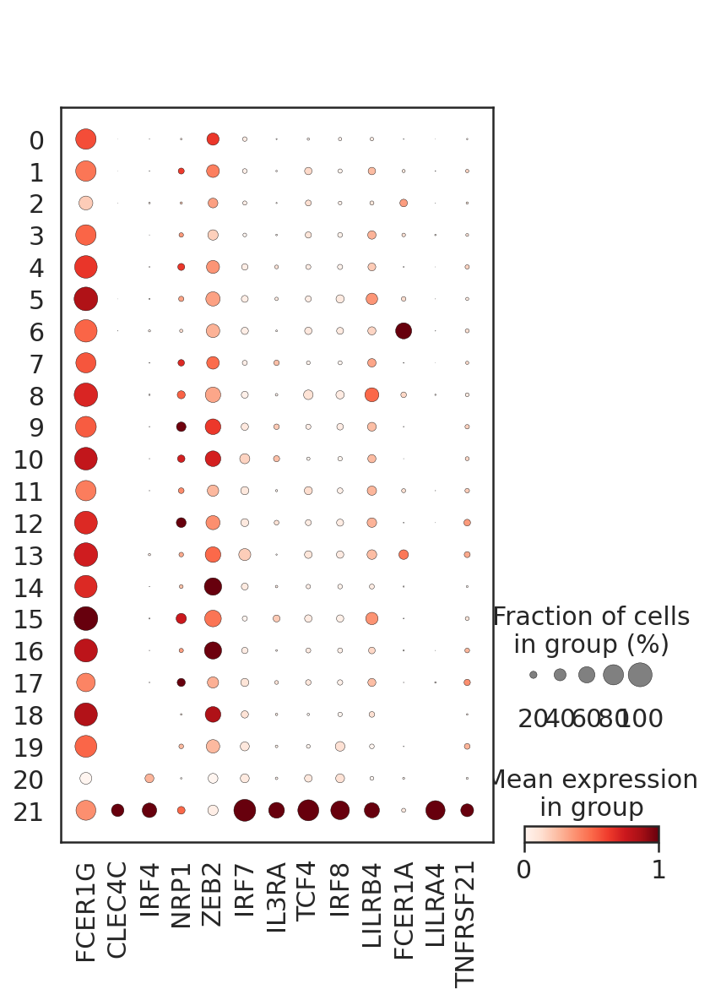

In [68]:
genes_of_interest = list(G.identities['p-DC'])

genes_of_interest = [x for x in genes_of_interest if x in adata.var_names]


sc.pl.dotplot(adata, genes_of_interest, groupby=pheno_heat, dendrogram=False, standard_scale='var')

In [64]:
adata.var['highly_variable'].value_counts()

highly_variable
False    11627
True      5055
Name: count, dtype: int64

In [27]:
sc.tl.rank_genes_groups(adata, pheno_heat, use_raw=None, groups='all', reference='rest', 
                            n_genes=None, rankby_abs=False, pts=False, key_added=None, copy=False, method=None, 
                            corr_method='benjamini-hochberg', tie_correct=False, layer=None)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:394: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/s

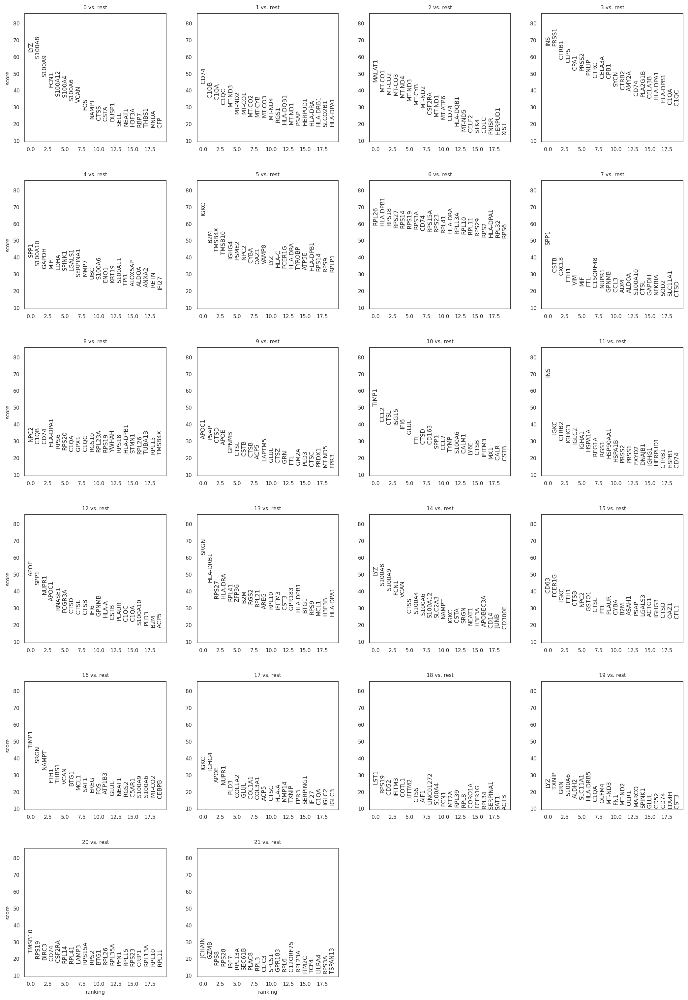

In [28]:
sc.pl.rank_genes_groups(adata)


# Annotate cells

In [41]:
#define adata, clusters and marker genes for heatmaps here
adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_5000hv_clustered_v2_230125.h5ad'
adata_save_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_5000hv_clustered_v2_230125_annotated.h5ad'

pheno_annotate = 'pheno_var_M_k30'
continue_with_adata = False

In [42]:
if continue_with_adata == False:
    adata = sc.read(adata_path)

In [43]:
#create unique subset cluster names to later merge with in one .obs column with the other subsets (B, M..)
pheno_k10_subset_list = [i+j for i,j in zip(len(adata.obs[pheno_annotate])*['M_'], list(map(str, adata.obs[pheno_annotate])))]
pheno_k10_subset_list

['M_2',
 'M_8',
 'M_1',
 'M_1',
 'M_6',
 'M_2',
 'M_6',
 'M_2',
 'M_0',
 'M_9',
 'M_6',
 'M_0',
 'M_0',
 'M_4',
 'M_2',
 'M_3',
 'M_10',
 'M_8',
 'M_10',
 'M_4',
 'M_2',
 'M_3',
 'M_14',
 'M_14',
 'M_14',
 'M_0',
 'M_18',
 'M_2',
 'M_14',
 'M_10',
 'M_13',
 'M_4',
 'M_5',
 'M_5',
 'M_4',
 'M_14',
 'M_3',
 'M_0',
 'M_15',
 'M_0',
 'M_7',
 'M_13',
 'M_11',
 'M_0',
 'M_0',
 'M_1',
 'M_15',
 'M_4',
 'M_1',
 'M_0',
 'M_15',
 'M_6',
 'M_8',
 'M_3',
 'M_0',
 'M_1',
 'M_3',
 'M_0',
 'M_5',
 'M_15',
 'M_5',
 'M_10',
 'M_10',
 'M_14',
 'M_3',
 'M_6',
 'M_10',
 'M_19',
 'M_3',
 'M_6',
 'M_4',
 'M_10',
 'M_6',
 'M_5',
 'M_9',
 'M_6',
 'M_6',
 'M_5',
 'M_9',
 'M_3',
 'M_5',
 'M_0',
 'M_16',
 'M_4',
 'M_3',
 'M_3',
 'M_6',
 'M_9',
 'M_3',
 'M_18',
 'M_4',
 'M_6',
 'M_2',
 'M_0',
 'M_7',
 'M_2',
 'M_11',
 'M_16',
 'M_3',
 'M_5',
 'M_5',
 'M_6',
 'M_7',
 'M_14',
 'M_16',
 'M_5',
 'M_0',
 'M_8',
 'M_7',
 'M_1',
 'M_8',
 'M_0',
 'M_2',
 'M_15',
 'M_13',
 'M_3',
 'M_5',
 'M_8',
 'M_9',
 'M_4',
 'M_3',
 '

In [44]:
#add to .obs element
adata.obs[pheno_annotate] = pheno_k10_subset_list

In [45]:
#mappings

##subtype_1

subtype_dict = {'M_0':'c-mono',
                'M_1':'Mac',
                'M_2':'Treg',
                'M_3':'Mac',
                'M_4':'Mac',
                 'M_5':'Mac',
                 'M_6':'cDC2',
                 'M_7':'Mac',
                 'M_8':'Mac',
                 'M_9':'Mac',
                 'M_10':'Mac',
                 'M_11':'Mac',
                 'M_12':'Mac',
                 'M_13':'Mac',
                 'M_14':'c-mono',
                 'M_15':'Mac',
                 'M_16':'PV-Mac',
                 'M_17':'Mac',
                 'M_18':'nc-mono',
                 'M_19':'Gr-MDC',
                 'M_20':'cDC3',
                 'M_21':'p-DC',
                  }













































In [46]:
#map with dictionary

adata.obs['annotation'] = adata.obs[pheno_annotate].map(subtype_dict)


In [20]:
#map with dictionary

adata.obs['annotation'] = adata.obs[pheno_annotate].map(subtype_dict)


In [78]:
new_annotations = []
old_annotations = list(adata.obs['annotation'] )
for i,v in enumerate(list(adata.obs['pheno_var_M_k10'])):
    if v == 38:
        new_annotations.append('cDC1')
    else:
        new_annotations.append(old_annotations[i])
set(new_annotations)
    

{'Gr-MDC',
 'Mac',
 'PV-Mac',
 'Treg',
 'c-mono',
 'cDC1',
 'cDC2',
 'cDC3',
 'nc-mono',
 'p-DC'}

In [79]:
adata.obs['annotation'] = new_annotations
set(adata.obs['annotation'])

{'Gr-MDC',
 'Mac',
 'PV-Mac',
 'Treg',
 'c-mono',
 'cDC1',
 'cDC2',
 'cDC3',
 'nc-mono',
 'p-DC'}

In [48]:
#define cell type hierarchy as nested dict
#define hierarchy as nested dict
hierarchy_dict = {
    'Pancreas': {
        'PL':{},
        'TNK': {
            'T_ILC': {
                'T':{
                    'MAIT':{},
                    'abT':{
                         'CD4-T':{'CD4-T-memory':{ 'CD4-TCM':{},
                                                  'CD4-TRM':{'CD4-TRM_terminally_exhausted':{},
                                                            'CD4-TRM-TH17':{}}},
                                    'CD4-T-naive':{},
                                                 'Treg':{}},
                         'CD8-T':{'CD8-T-KLRG1neg-effector':{'CD8-T-KLRG1neg-effector_nonexhausted':{}},
                                  'CD8-T-KLRG1pos-effector':{'CD8-T-KLRG1pos-effector_nonexhausted':{},
                                                            'CD8-T-KLRG1pos-effector_preexhausted':{}},
                                'CD8-T-memory':{'CD8-TRM':{'CD8-TRM_terminally_exhausted':{},
                                                          'CD8-TRM_nonexhausted':{}}},
                                'CD8-T-naive':{}},
                    'T_proliferating':{},
                    }
                },
                'NK-ILC':{'NK':{'CD56bright-NK':{},
                                'CD56dim-NK':{}},
                         'ILC3':{'ILC3-NCR2pos':{}}}
            },
        }, 
        'BP': {'B':{
            'B-memory':{},
                 'B-naive':{}},
                 'plasma-blast':{}},
        'M': {'mono':
                {'c-mono':{},
                'i-mono':{},
                'nc-mono':{}},
              'DC':{'p-DC':{},
                   'cDC1':{},
                   'cDC2':{},
                   'cDC3':{}},
                'Mac':{'PV-Mac':{}},
              'Gr-MDC':{}
                  
              
              }
    }
}

In [101]:
#define hierarchy class
H = hierarchy(hierarchy_dict)
H

Hierarchy class containing 50 cell types:['B', 'B-memory', 'B-naive', 'BP', 'CD4-T', 'CD4-T-memory', 'CD4-T-naive', 'CD4-TCM', 'CD4-TRM', 'CD4-TRM-TH17', 'CD4-TRM_terminally_exhausted', 'CD56bright-NK', 'CD56dim-NK', 'CD8-T', 'CD8-T-KLRG1neg-effector', 'CD8-T-KLRG1neg-effector_nonexhausted', 'CD8-T-KLRG1pos-effector', 'CD8-T-KLRG1pos-effector_nonexhausted', 'CD8-T-KLRG1pos-effector_preexhausted', 'CD8-T-memory', 'CD8-T-naive', 'CD8-TRM', 'CD8-TRM_nonexhausted', 'CD8-TRM_terminally_exhausted', 'DC', 'ILC3', 'ILC3-NCR2pos', 'M', 'MAIT', 'Mac', 'NK', 'NK-ILC', 'PL', 'PV-Mac', 'Pancreas', 'T', 'TNK', 'T_ILC', 'T_proliferating', 'Treg', 'abT', 'c-mono', 'cDC1', 'cDC2', 'cDC3', 'i-mono', 'mono', 'nc-mono', 'p-DC', 'plasma-blast']


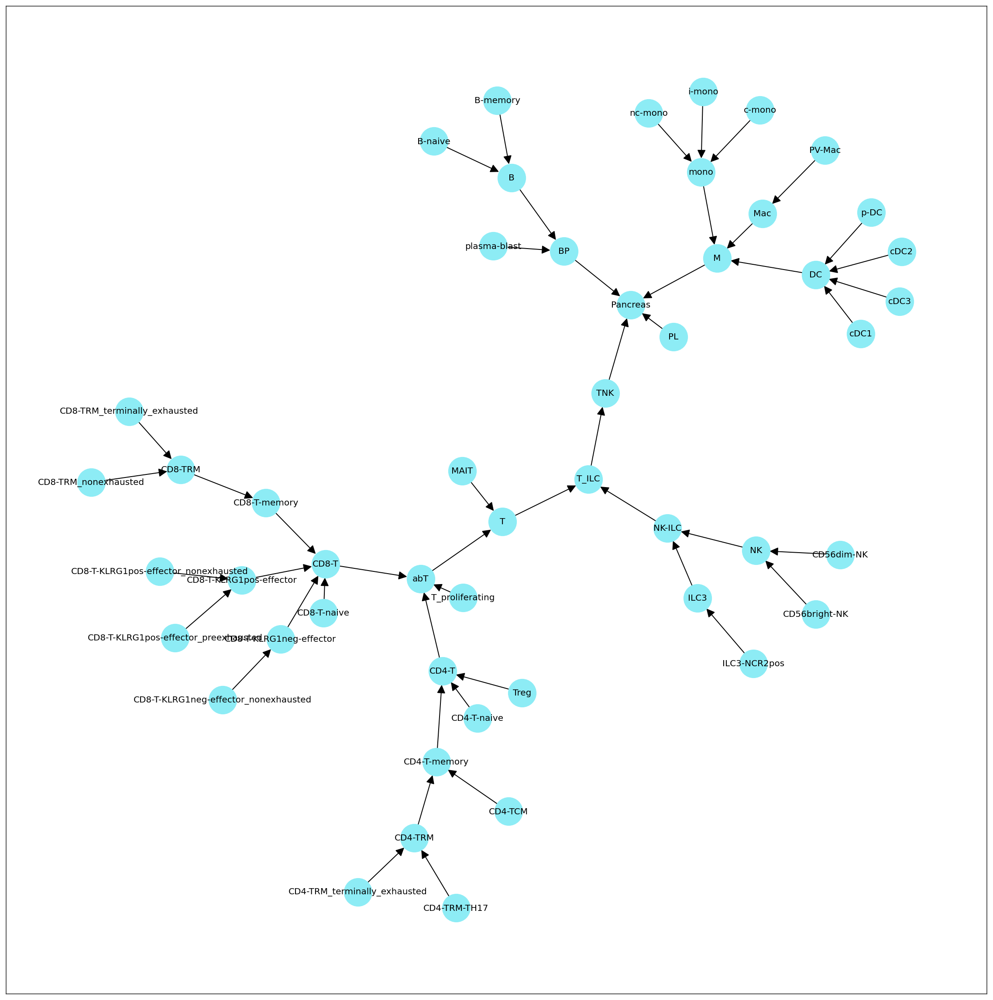

In [102]:
#inspect cell type hierarchy
H.plot_celltypes(figsize=[20,20])

In [103]:
#add cells to annotation object
H.add_cells(adata, obs_columns=['annotation'])

In [104]:
#starting on top of the hierarchy we can find the most granular cell type label for each cell
H.query_ancestors(query_node='Pancreas', adata=adata, obs_key='hierarchical_query')

In [105]:
#the output will be added to a dictionary
H.annotations.keys()

dict_keys(['cDC3', 'ILC3-NCR2pos', 'BP', 'CD8-T-KLRG1pos-effector_nonexhausted', 'c-mono', 'CD4-TRM_terminally_exhausted', 'mono', 'NK-ILC', 'DC', 'abT', 'CD8-TRM_terminally_exhausted', 'CD8-TRM_nonexhausted', 'T_proliferating', 'CD4-TRM', 'MAIT', 'Pancreas', 'TNK', 'ILC3', 'CD4-TRM-TH17', 'nc-mono', 'NK', 'B', 'CD4-T', 'cDC2', 'CD8-T-memory', 'T', 'PL', 'Treg', 'CD8-TRM', 'CD56dim-NK', 'CD8-T-KLRG1neg-effector_nonexhausted', 'Mac', 'B-naive', 'CD8-T-KLRG1pos-effector_preexhausted', 'i-mono', 'plasma-blast', 'p-DC', 'CD8-T-KLRG1pos-effector', 'M', 'CD8-T', 'CD4-T-naive', 'B-memory', 'CD4-TCM', 'CD4-T-memory', 'CD8-T-naive', 'T_ILC', 'CD8-T-KLRG1neg-effector', 'CD56bright-NK', 'cDC1', 'PV-Mac'])

In [106]:
adata = randomize_cells(adata)

/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


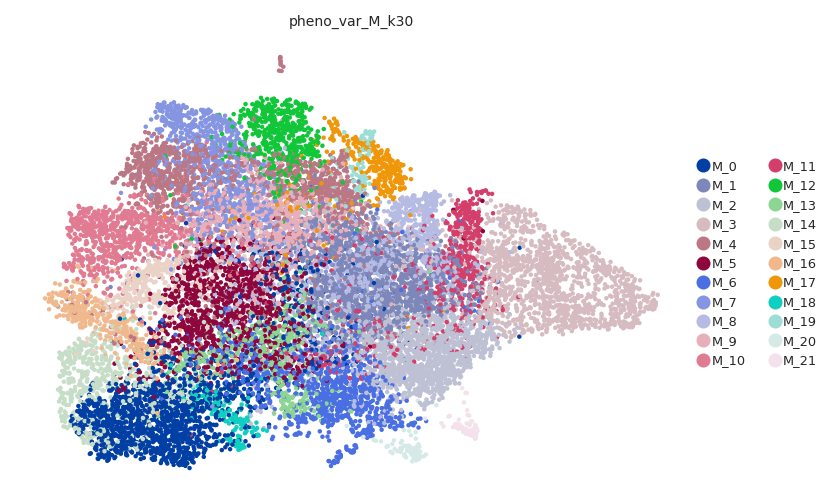

In [107]:
%matplotlib inline
sc.pl.umap(adata,color=pheno_heat,s=20)

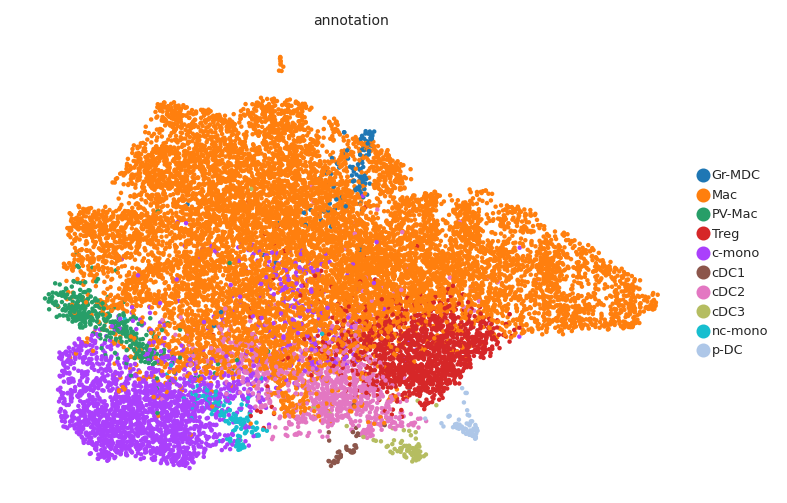

In [108]:
%matplotlib inline
sc.pl.umap(adata,color='annotation',s=20)

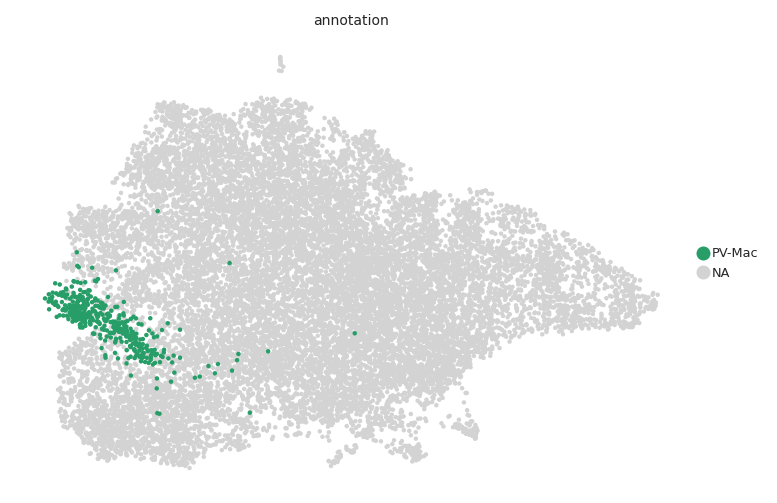

In [113]:
%matplotlib inline
sc.pl.umap(adata,color='annotation',groups=['PV-Mac'],s=20)

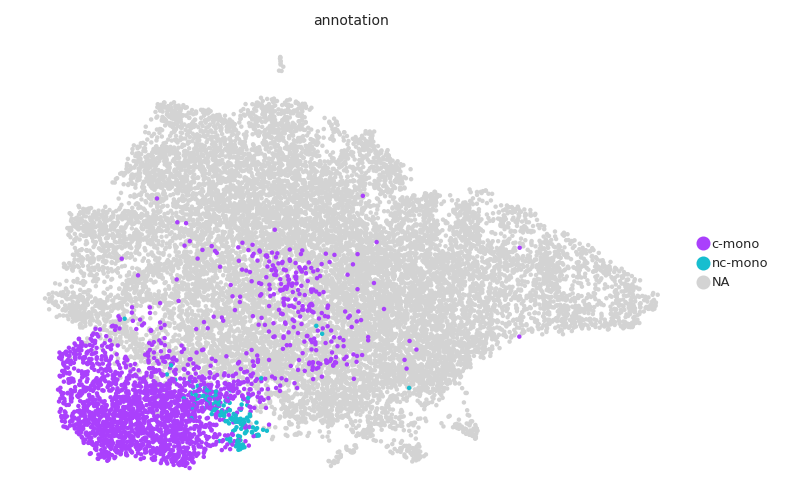

In [109]:
%matplotlib inline
sc.pl.umap(adata,color='annotation',groups=['c-mono','nc-mono'],s=20)

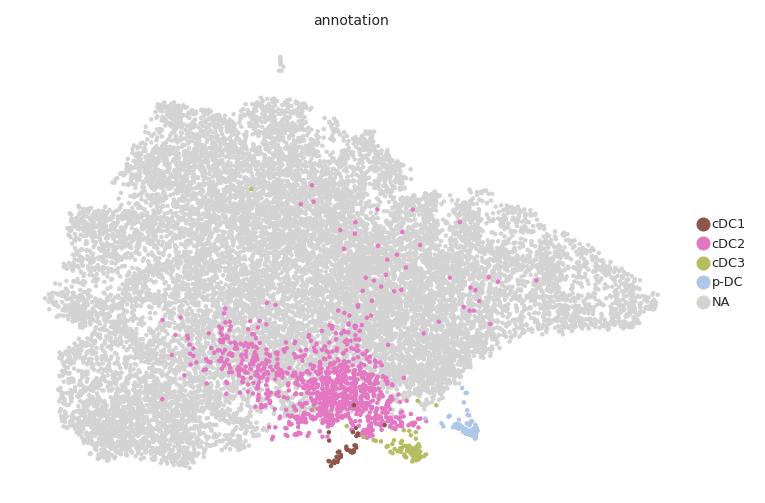

In [110]:
%matplotlib inline
sc.pl.umap(adata,color='annotation',groups=['p-DC','cDC2','cDC3','cDC1'],s=20)

In [111]:
#and to the adata
adata.obs['hierarchical_query'].head()

192729608316773-T17       Mac
155971444729643-T02      cDC2
134600608898355-T19       Mac
240154798876526-T09       Mac
131293502958372-T22    c-mono
Name: hierarchical_query, dtype: category
Categories (9, object): ['Mac', 'PV-Mac', 'Treg', 'c-mono', ..., 'cDC2', 'cDC3', 'nc-mono', 'p-DC']

In [114]:
#starting on top of the hierarchy we can find the most granular cell type label for each cell
H.query_ancestors(query_node='DC', adata=adata, obs_key='DC')

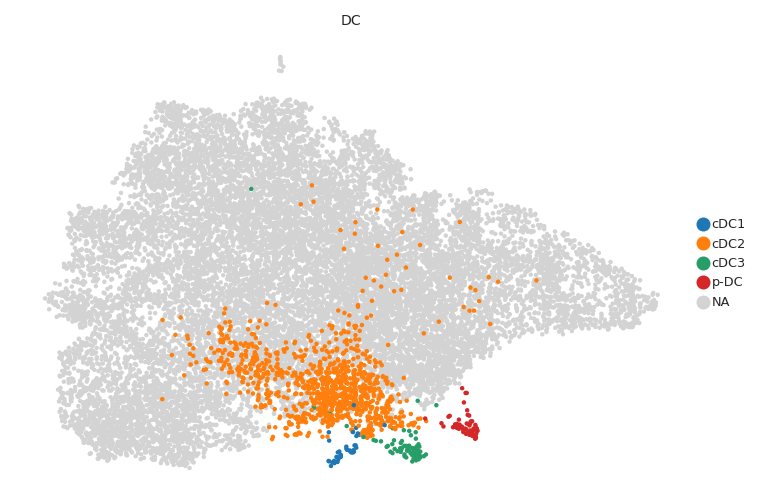

In [115]:
%matplotlib inline
sc.pl.umap(adata,color='DC',s=20)

In [116]:
set(adata.obs['annotation'])

{'Gr-MDC',
 'Mac',
 'PV-Mac',
 'Treg',
 'c-mono',
 'cDC1',
 'cDC2',
 'cDC3',
 'nc-mono',
 'p-DC'}

In [117]:
adata_save_path

'/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_M_scran_raw_counts_annotated_5000hv_clustered_v2_230125_annotated.h5ad'

In [ ]:
adata.write(adata_save_path)
print('AnnData object saved to:', adata_save_path)